In [1]:
import wfdb
import matplotlib.pyplot as plt
import numpy as np
import os
from scipy.signal import medfilt
import pywt
from ecgdetectors import Detectors

In [2]:
scd_data = {'./data/scddb/30': '07:54:33',
 './data/scddb/31': '13:42:24',
 './data/scddb/32': '16:45:18',
 './data/scddb/33': '04:46:19',
 './data/scddb/34': '06:35:44',
 './data/scddb/35': '24:34:56',
 './data/scddb/36': '18:59:01',
 './data/scddb/37': '01:31:13',
 './data/scddb/38': '08:01:54',
 './data/scddb/39': '04:37:51',
 './data/scddb/41': '02:59:24',
 './data/scddb/43': '15:37:11',
 './data/scddb/44': '19:38:45',
 './data/scddb/45': '18:09:17',
 './data/scddb/46': '03:41:47',
 './data/scddb/47': '06:13:01',
 './data/scddb/48': '02:29:40',
 './data/scddb/50': '11:45:43',
 './data/scddb/51': '22:58:23',
 './data/scddb/52': '02:32:40'}


fs = 250

In [3]:
def hms_to_seconds(hms):
    h, m, s = hms.split(':')
    return int(h)*3600 + int(m)*60 + int(s)

In [4]:
def extract_before_onset_VF(vfon_dict, minutes_before=30):
    ecg_data_map = {} 

    for record_path, vf_onset_str in vfon_dict.items():
        # record_path might be '.data/scddb/30'
        record_dir, record_name = os.path.split(record_path)

        # 2) Convert dictionary's VF onset to seconds
        vf_onset_original_sec = hms_to_seconds(vf_onset_str)

        vfon_onset_original_sample = vf_onset_original_sec * fs

        seg_len_samples = int(minutes_before * 60 * fs)

        start_sample = vfon_onset_original_sample - seg_len_samples

         # read .dat between those sample indices
        try:
            #record_dat_path = os.path.join(record_dir, record_name)  # base path
            record_path_dat = os.path.join(record_dir, record_name)
            segment = wfdb.rdrecord(record_path_dat, sampfrom=start_sample, sampto=vfon_onset_original_sample)
            
        except Exception as e:
            print(f"[ERROR] Failed to read record {record_dat_path}: {e}")
            continue

        # Retrieve the raw signal data as a NumPy array
        if segment.p_signal is not None:
            arr = segment.p_signal[:,0]
            ecg_data_map[record_name] = arr
            print(f"[OK] Extracted 30-min for {record_name}: shape={arr.shape}")
        else:
            print(f"[WARNING] No p_signal found for {record_name}")

    return ecg_data_map

In [5]:
onsetVF_30min_scd = extract_before_onset_VF(scd_data, minutes_before=30)

[OK] Extracted 30-min for 30: shape=(450000,)
[OK] Extracted 30-min for 31: shape=(450000,)
[OK] Extracted 30-min for 32: shape=(450000,)
[OK] Extracted 30-min for 33: shape=(450000,)
[OK] Extracted 30-min for 34: shape=(450000,)
[OK] Extracted 30-min for 35: shape=(450000,)
[OK] Extracted 30-min for 36: shape=(450000,)
[OK] Extracted 30-min for 37: shape=(450000,)
[OK] Extracted 30-min for 38: shape=(450000,)
[OK] Extracted 30-min for 39: shape=(450000,)
[OK] Extracted 30-min for 41: shape=(450000,)
[OK] Extracted 30-min for 43: shape=(450000,)
[OK] Extracted 30-min for 44: shape=(450000,)
[OK] Extracted 30-min for 45: shape=(450000,)
[OK] Extracted 30-min for 46: shape=(450000,)
[OK] Extracted 30-min for 47: shape=(450000,)
[OK] Extracted 30-min for 48: shape=(450000,)
[OK] Extracted 30-min for 50: shape=(450000,)
[OK] Extracted 30-min for 51: shape=(450000,)
[OK] Extracted 30-min for 52: shape=(450000,)


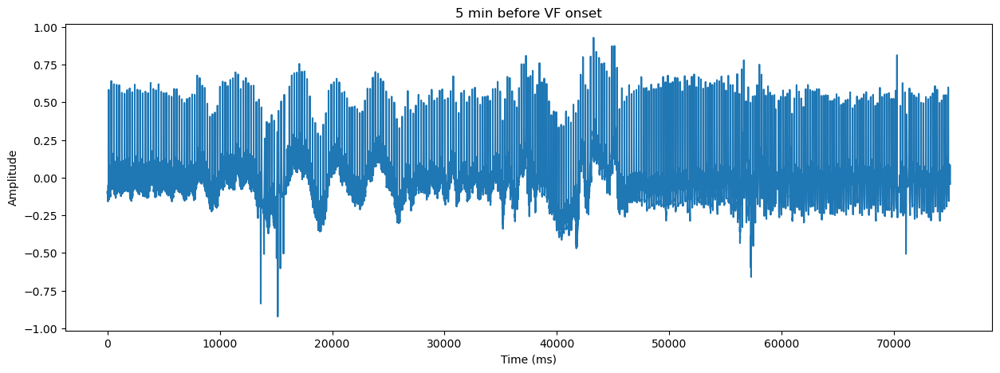

In [6]:
scd_30 = onsetVF_30min_scd['30']

plt.figure(figsize=(15, 5))
plt.subplot()
plt.plot(scd_30[-75000:])
plt.title('5 min before VF onset')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.show()

# Denoise

In [8]:
def denoise_signal(X, dwt_transform, dlevels, cutoff_low, cutoff_high):
    coeffs = pywt.wavedec(X, dwt_transform, level=dlevels)   # wavelet transform 'bior4.4'
    # scale 0 to cutoff_low 
    for ca in range(0,cutoff_low):
        coeffs[ca]=np.multiply(coeffs[ca],[0.0])
    # scale cutoff_high to end
    for ca in range(cutoff_high, len(coeffs)):
        coeffs[ca]=np.multiply(coeffs[ca],[0.0])
    Y = pywt.waverec(coeffs, dwt_transform) # inverse wavelet transform
    return Y  

In [10]:
scd_30_denoised_1 = denoise_signal(scd_30,'bior4.4', 9 , 1 , 7)

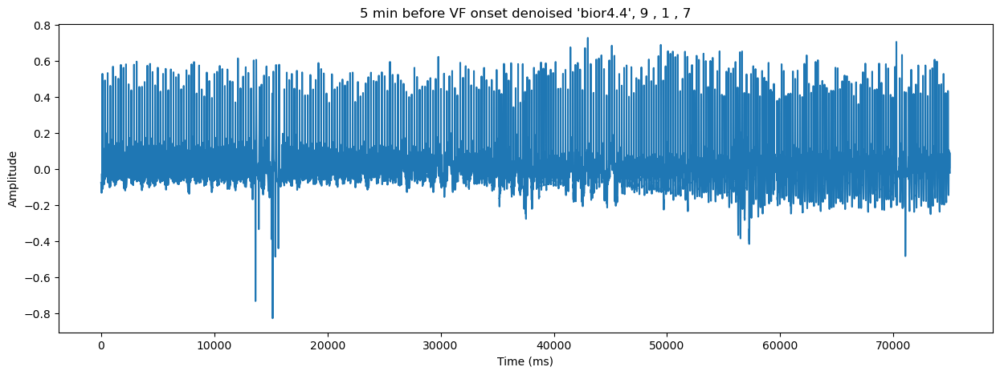

In [12]:
plt.figure(figsize=(15, 5))
plt.subplot()
plt.plot(scd_30_denoised_1[-75000:])
plt.title('5 min before VF onset denoised \'bior4.4\', 9 , 1 , 7')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.show()

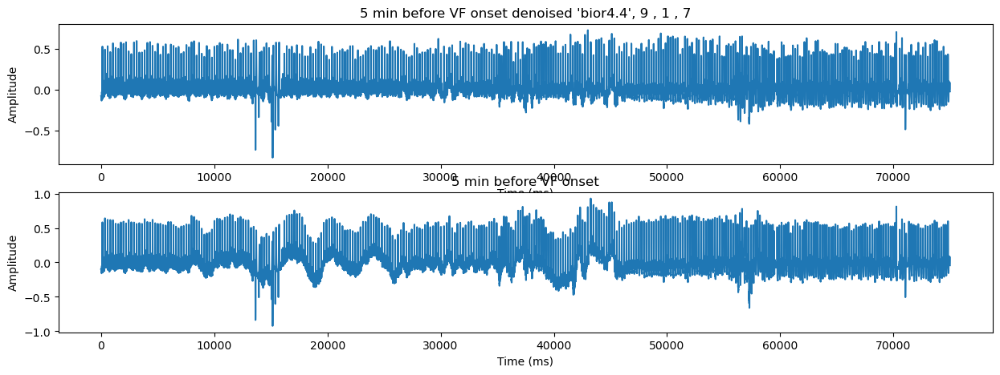

In [14]:
plt.figure(figsize=(15, 5))
plt.subplot(2, 1, 1)
plt.plot(scd_30_denoised_1[-75000:])
plt.title('5 min before VF onset denoised \'bior4.4\', 9 , 1 , 7')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.subplot(2, 1, 2)
plt.plot(scd_30[-75000:])
plt.title('5 min before VF onset')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.show()

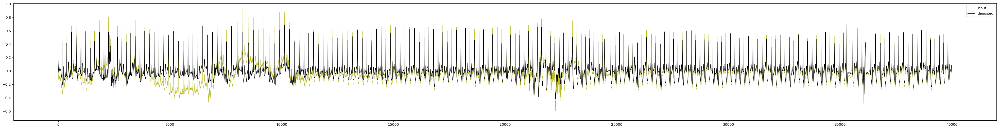

In [22]:
plt.figure(figsize=(50,6))

plt.plot(scd_30[-40000:], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(scd_30_denoised_1[-40000:], color='black', linewidth=0.9,label = 'denoised')
plt.hlines(0,0,40000,color='black', linewidth=0.4)
plt.legend()
plt.show()

In [23]:
np.any(np.isnan(scd_30_denoised_1))

np.False_

### version2

In [24]:
scd_30_denoised_2  = denoise_signal(scd_30,'sym5', 8 , 0 , 7) # 8 level fine (8, 0, 7)

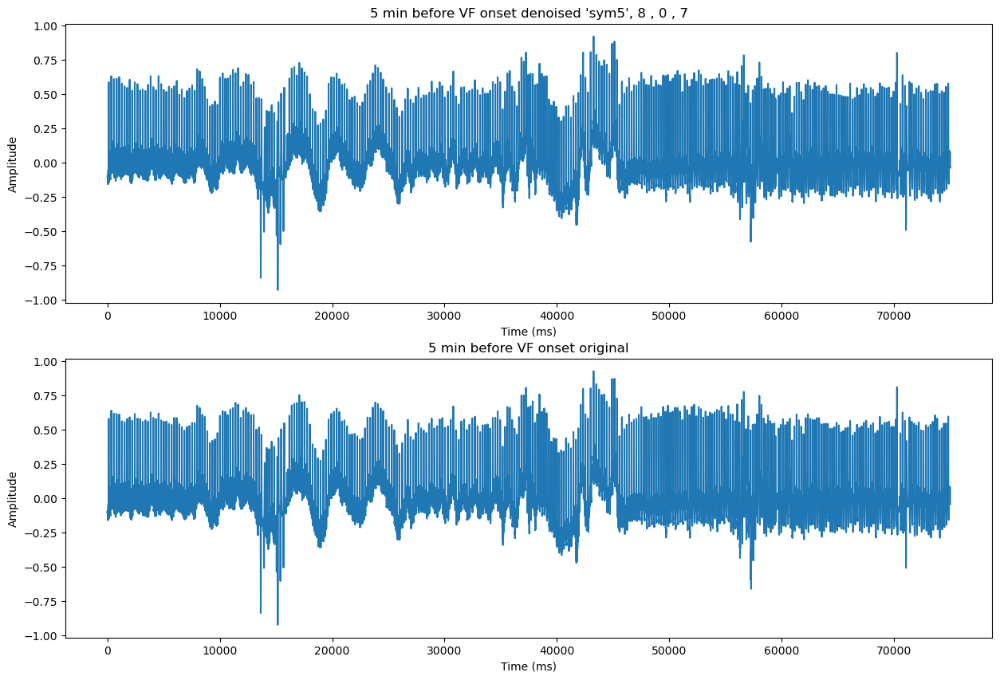

In [28]:
plt.figure(figsize=(15, 10))
plt.subplot(2, 1, 1)
plt.plot(scd_30_denoised_2[-75000:])
plt.title('5 min before VF onset denoised \'sym5\', 8 , 0 , 7')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.subplot(2, 1, 2)
plt.plot(scd_30[-75000:])
plt.title('5 min before VF onset original')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.show()

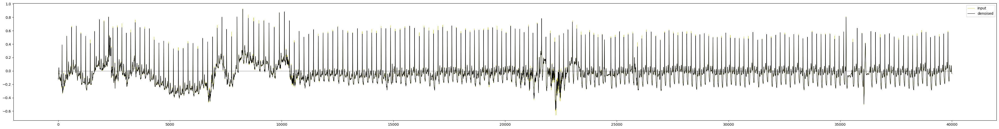

In [31]:
plt.figure(figsize=(50,6))

plt.plot(scd_30[-40000:], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(scd_30_denoised_2[-40000:], color='black', linewidth=0.9,label = 'denoised')
plt.hlines(0,0,40000,color='black', linewidth=0.4)
plt.legend()
plt.show()

In [32]:
np.any(np.isnan(scd_30_denoised_2))

np.False_

# fams

In [35]:
pywtfam = pywt.families()

In [39]:
for i in range(len(pywtfam)):
    print(pywt.wavelist(pywtfam[i]))
    print("-"*60)

['haar']
------------------------------------------------------------
['db1', 'db2', 'db3', 'db4', 'db5', 'db6', 'db7', 'db8', 'db9', 'db10', 'db11', 'db12', 'db13', 'db14', 'db15', 'db16', 'db17', 'db18', 'db19', 'db20', 'db21', 'db22', 'db23', 'db24', 'db25', 'db26', 'db27', 'db28', 'db29', 'db30', 'db31', 'db32', 'db33', 'db34', 'db35', 'db36', 'db37', 'db38']
------------------------------------------------------------
['sym2', 'sym3', 'sym4', 'sym5', 'sym6', 'sym7', 'sym8', 'sym9', 'sym10', 'sym11', 'sym12', 'sym13', 'sym14', 'sym15', 'sym16', 'sym17', 'sym18', 'sym19', 'sym20']
------------------------------------------------------------
['coif1', 'coif2', 'coif3', 'coif4', 'coif5', 'coif6', 'coif7', 'coif8', 'coif9', 'coif10', 'coif11', 'coif12', 'coif13', 'coif14', 'coif15', 'coif16', 'coif17']
------------------------------------------------------------
['bior1.1', 'bior1.3', 'bior1.5', 'bior2.2', 'bior2.4', 'bior2.6', 'bior2.8', 'bior3.1', 'bior3.3', 'bior3.5', 'bior3.7', 'bi

# bior fam

In [40]:
biorfam = ['bior1.1', 'bior1.3', 'bior1.5', 'bior2.2', 'bior2.4', 'bior2.6', 'bior2.8', 'bior3.1', 'bior3.3', 'bior3.5', 'bior3.7', 'bior3.9', 'bior4.4', 'bior5.5', 'bior6.8']

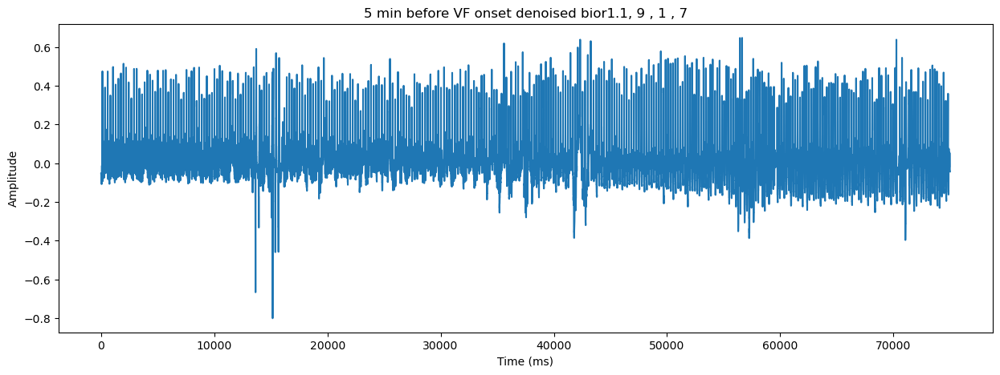

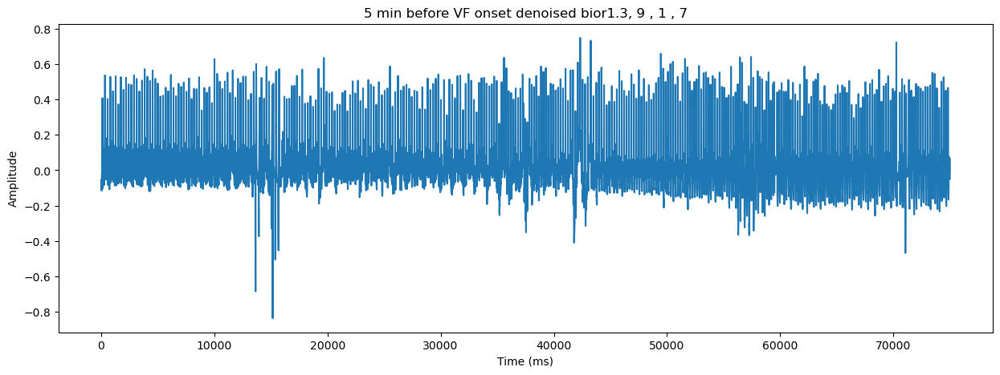

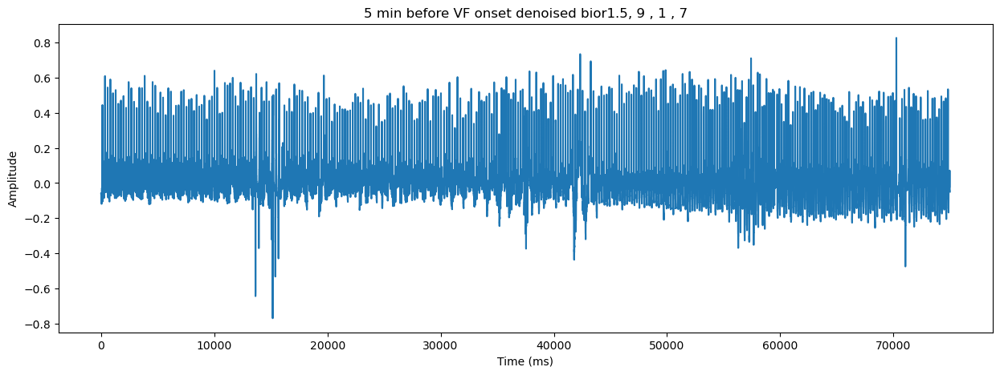

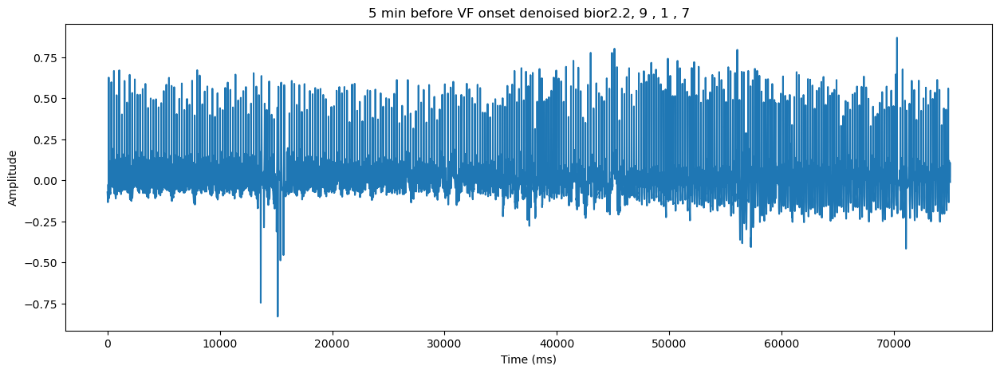

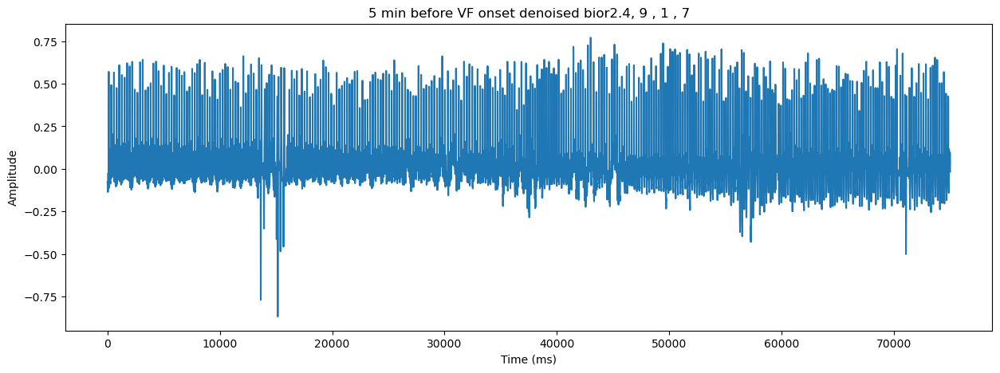

...

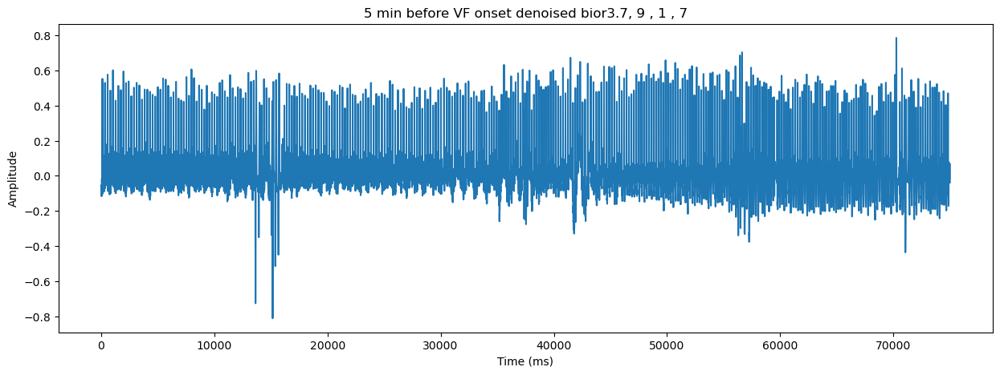

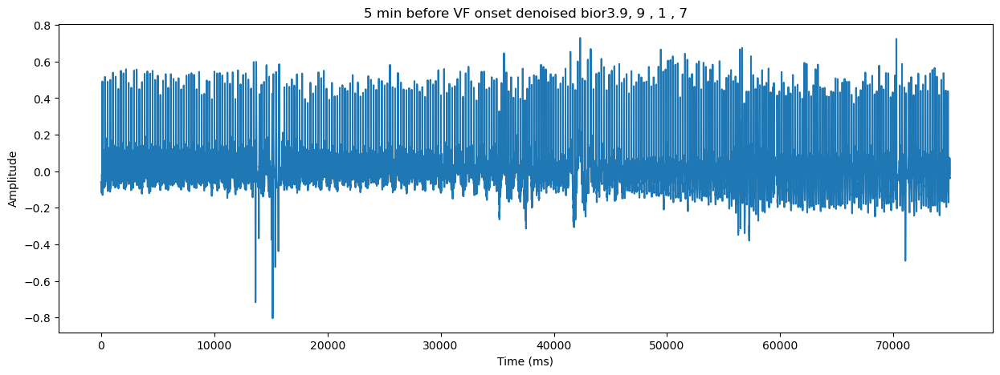

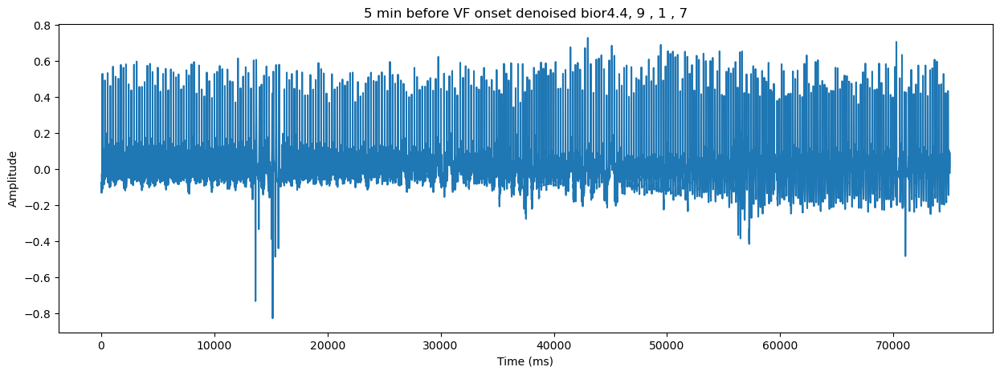

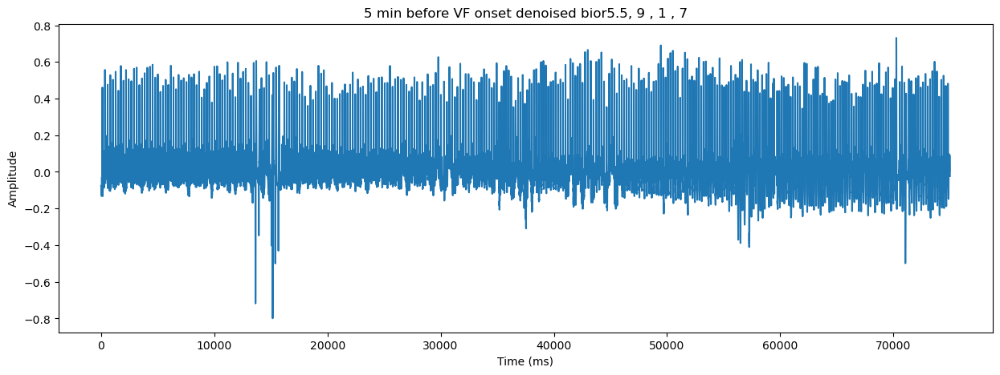

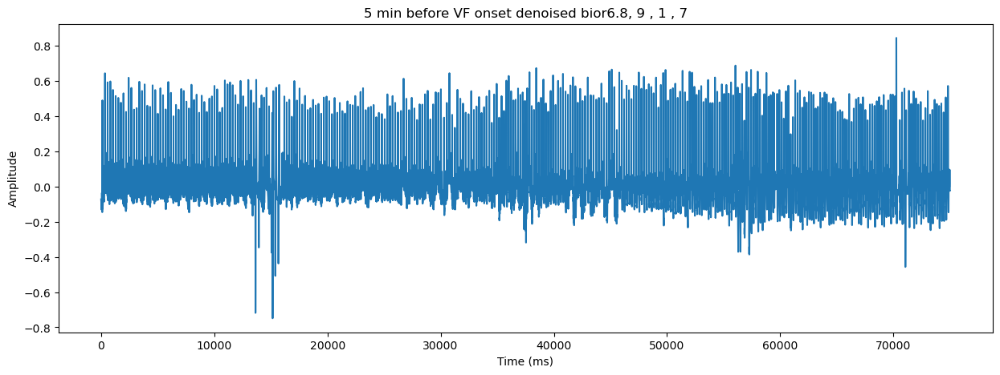

In [41]:
for i in range(len(biorfam)):
    scd_30_denoised_ex = denoise_signal(scd_30, biorfam[i], 9 , 1 , 7)
    
    plt.figure(figsize=(15, 5))
    plt.subplot()
    plt.plot(scd_30_denoised_ex[-75000:])
    plt.title(f'5 min before VF onset denoised {biorfam[i]}, 9 , 1 , 7')
    plt.xlabel('Time (ms)')
    plt.ylabel('Amplitude')
    
    plt.show()

# sym fam

In [42]:
symfam = ['sym2', 'sym3', 'sym4', 'sym5', 'sym6', 'sym7', 'sym8', 'sym9', 'sym10', 'sym11', 'sym12', 'sym13', 'sym14', 'sym15', 'sym16', 'sym17', 'sym18', 'sym19', 'sym20']

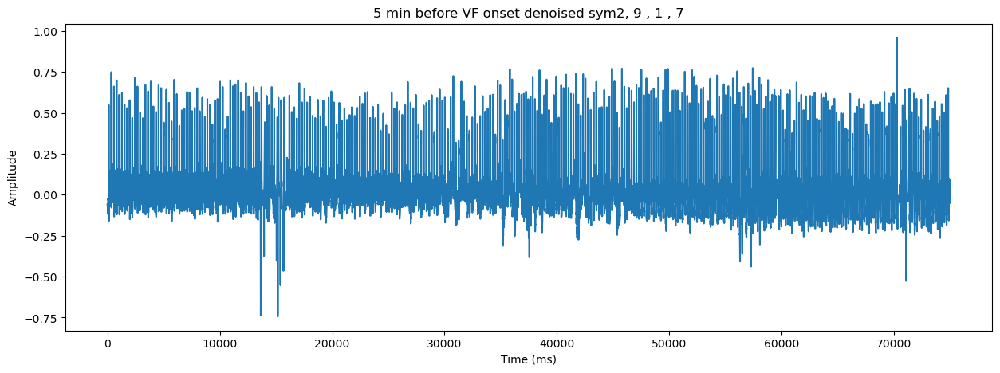

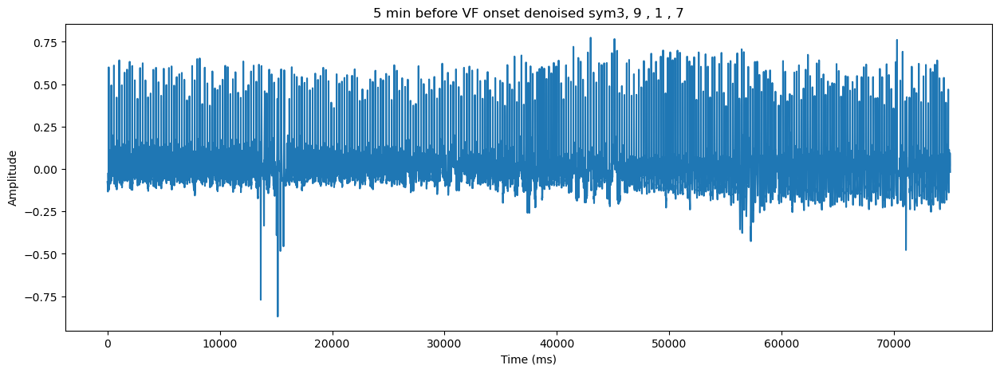

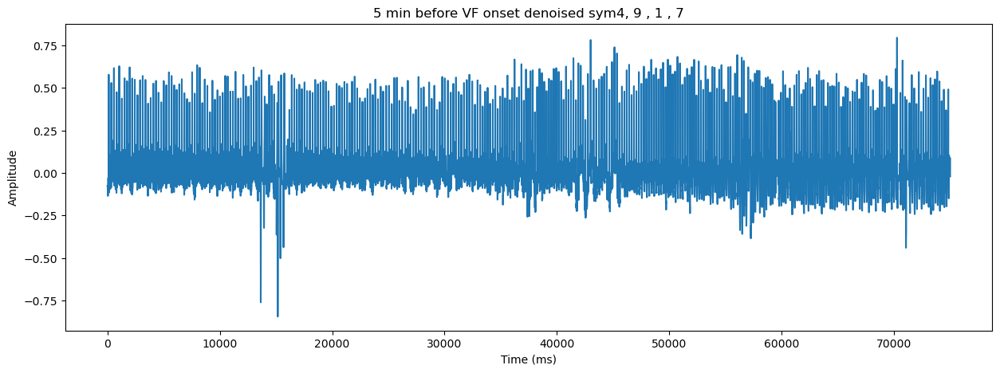

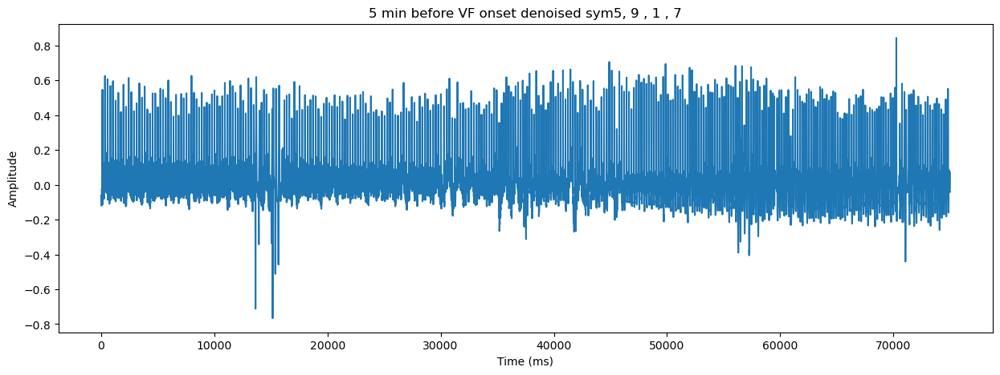

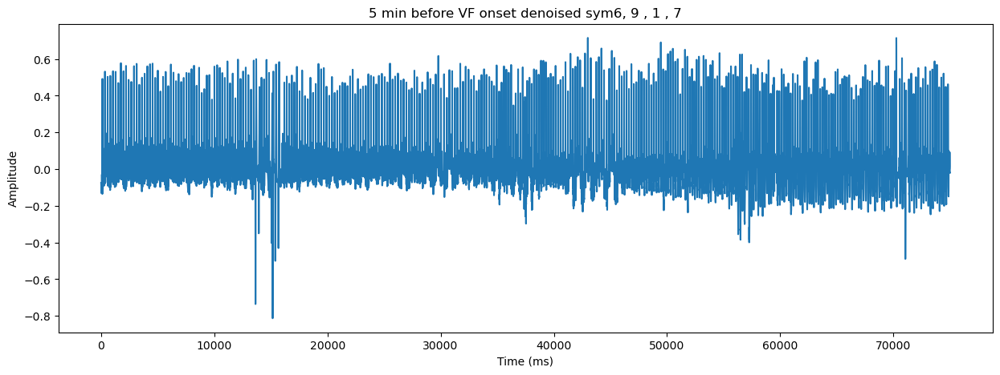

...

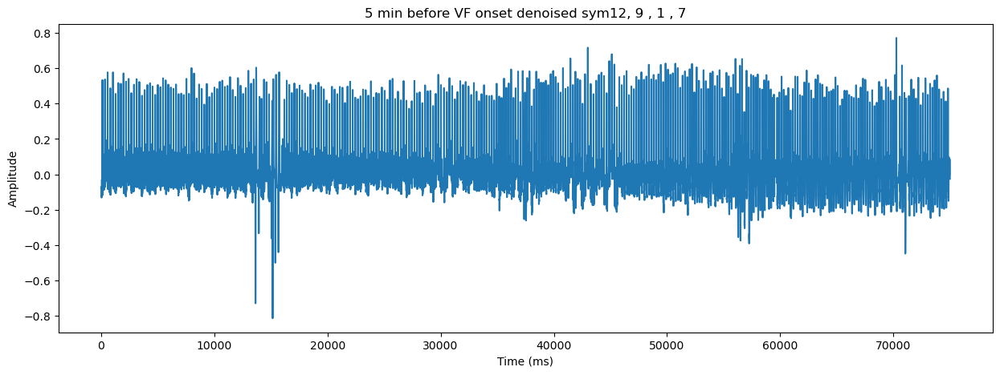

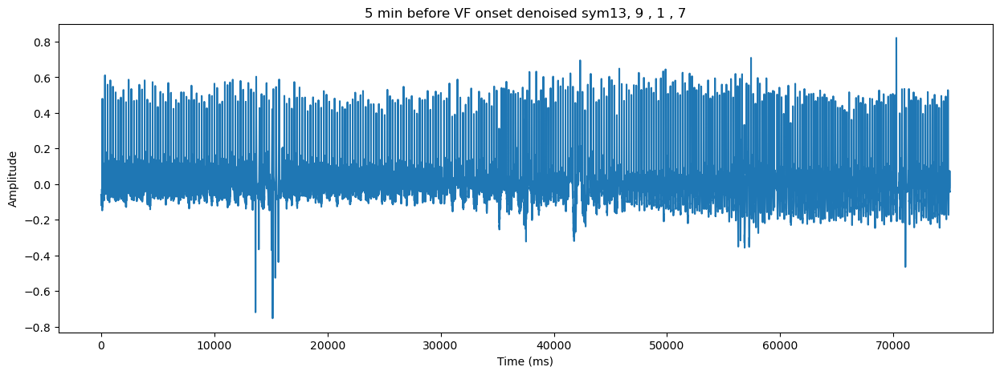

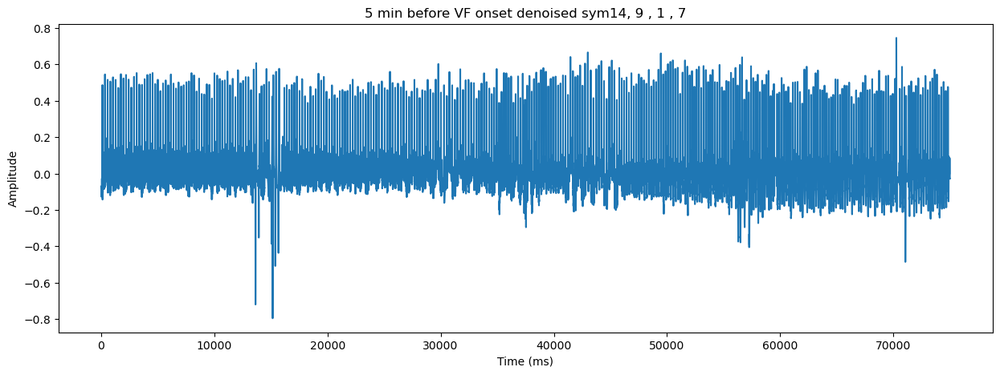

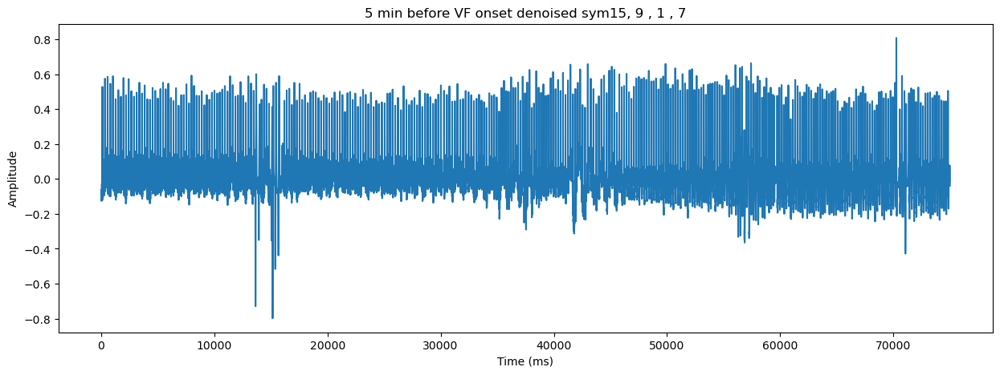

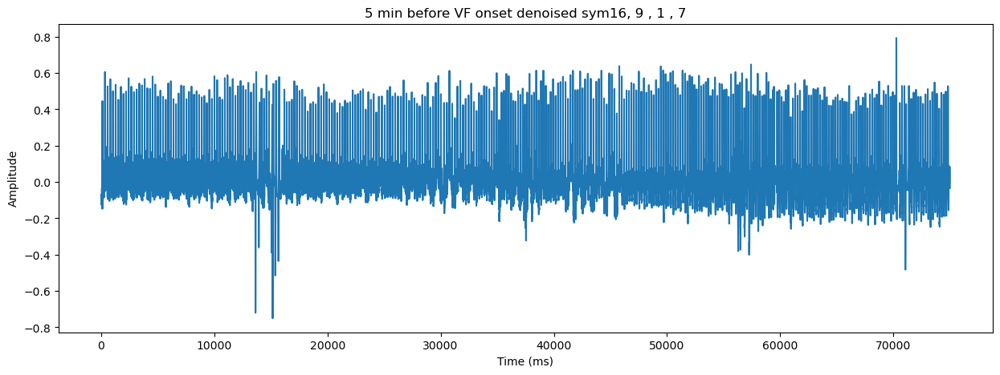

In [43]:
for i in range(len(biorfam)):
    scd_30_denoised_ex = denoise_signal(scd_30, symfam[i], 9 , 1 , 7)
    
    plt.figure(figsize=(15, 5))
    plt.subplot()
    plt.plot(scd_30_denoised_ex[-75000:])
    plt.title(f'5 min before VF onset denoised {symfam[i]}, 9 , 1 , 7')
    plt.xlabel('Time (ms)')
    plt.ylabel('Amplitude')
    
    plt.show()

False


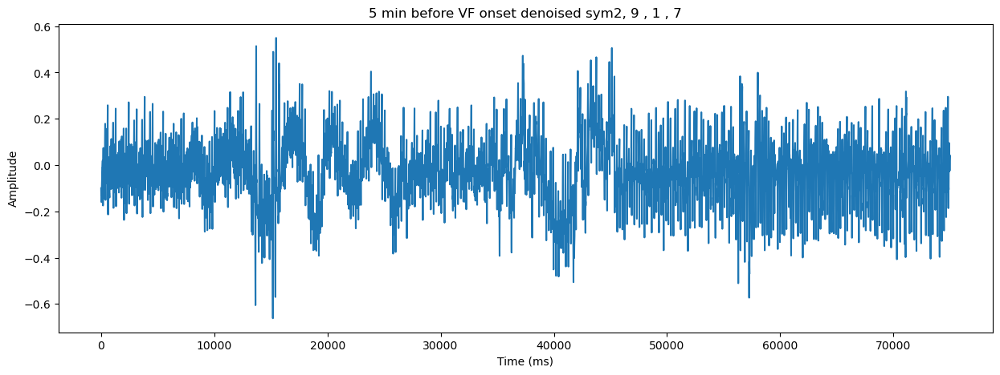

False


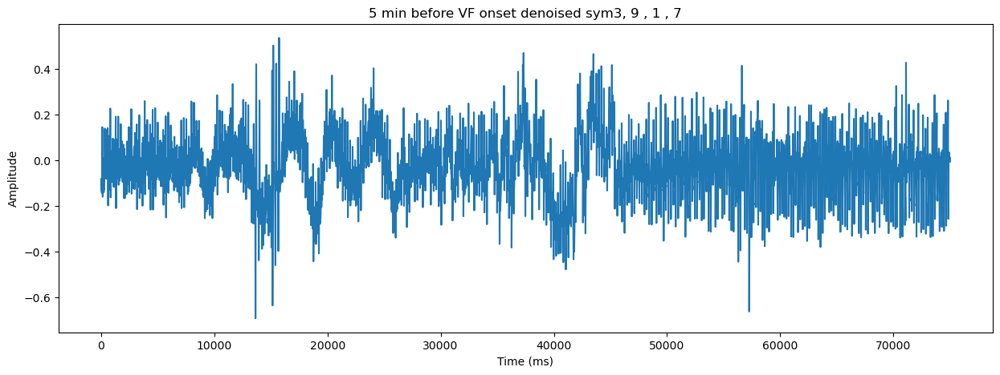

False


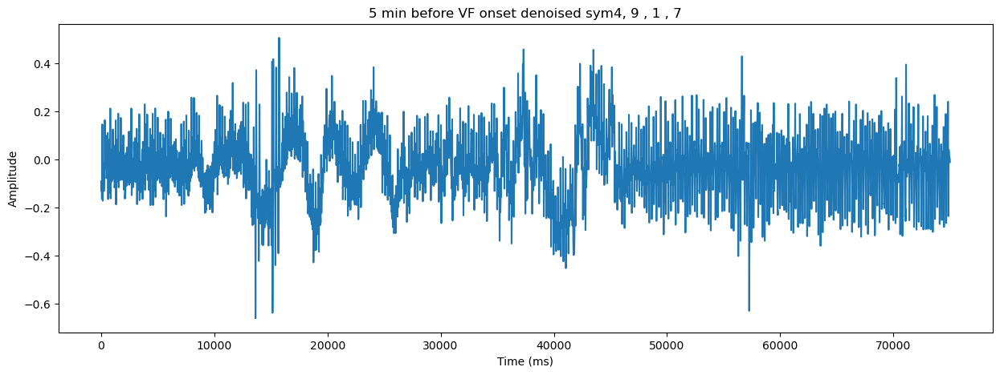

False


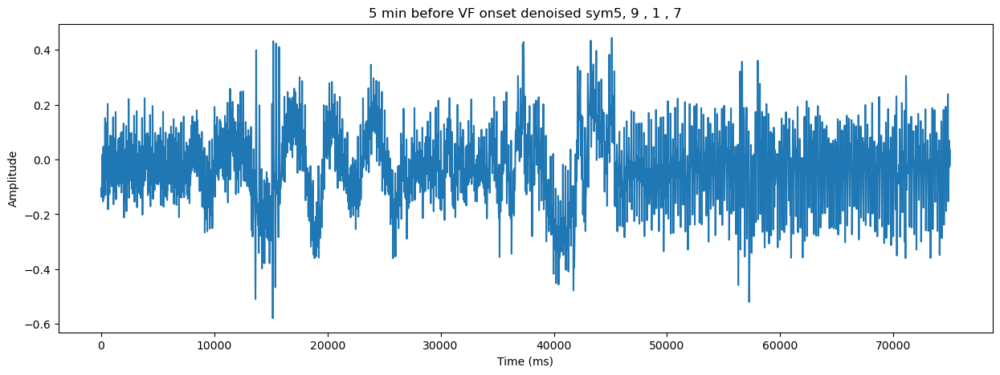

False


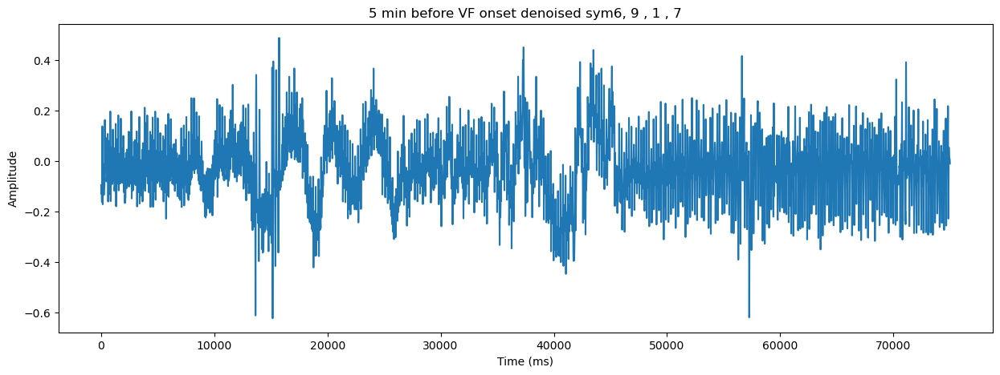

False


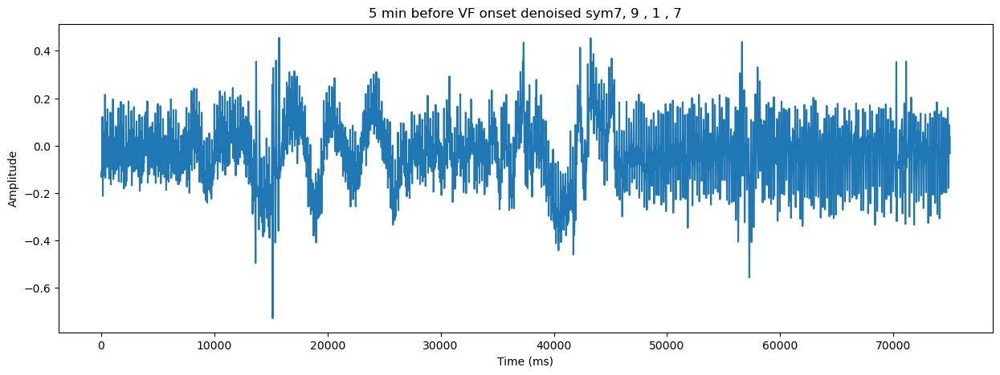

False


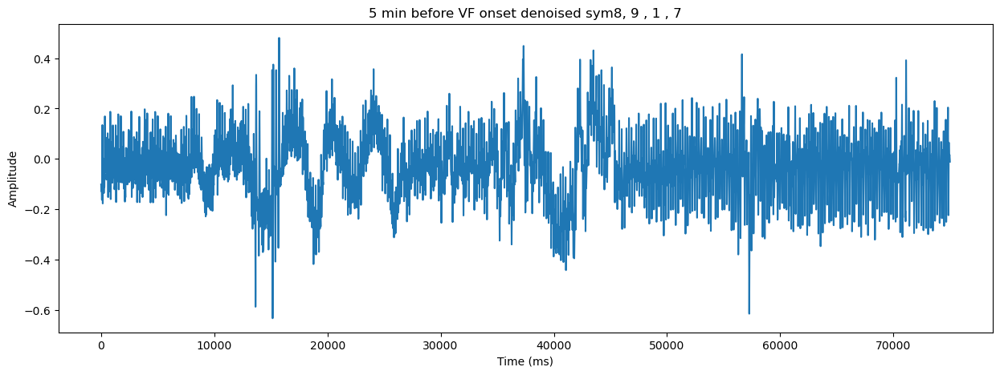

False


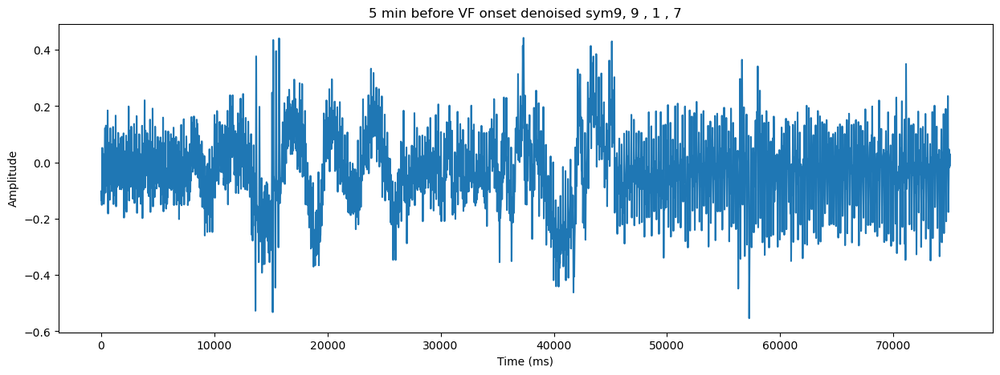

False


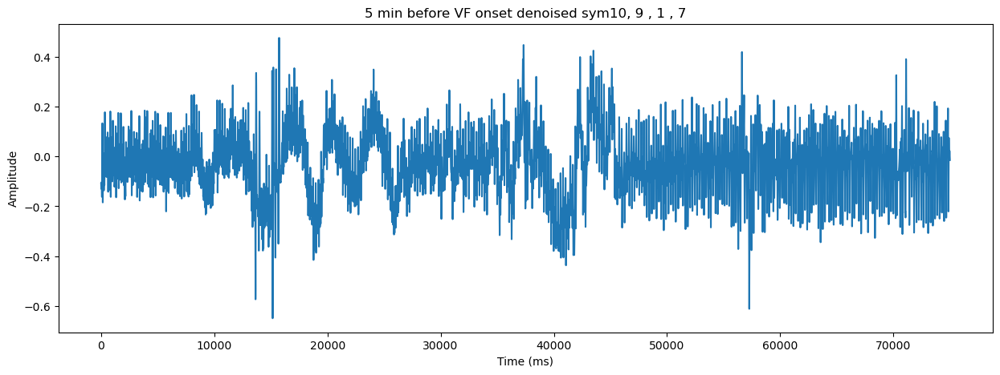

False


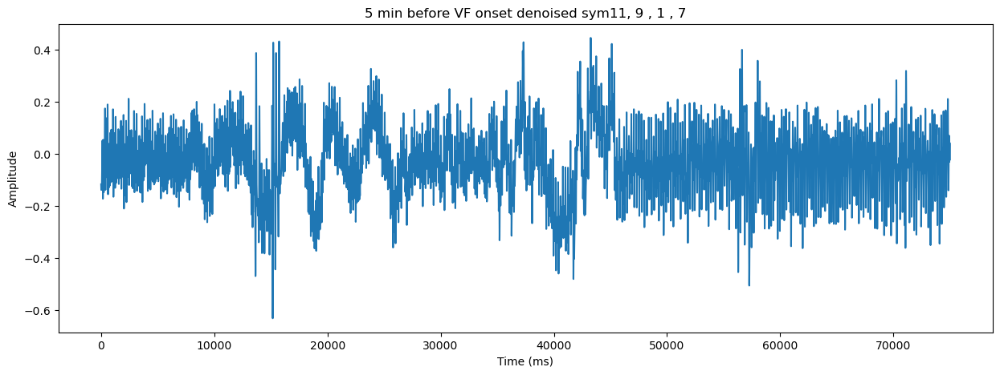

False


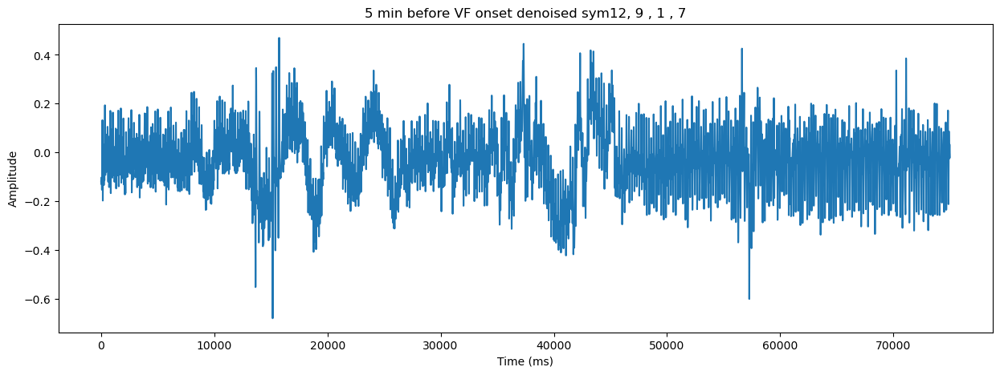

False


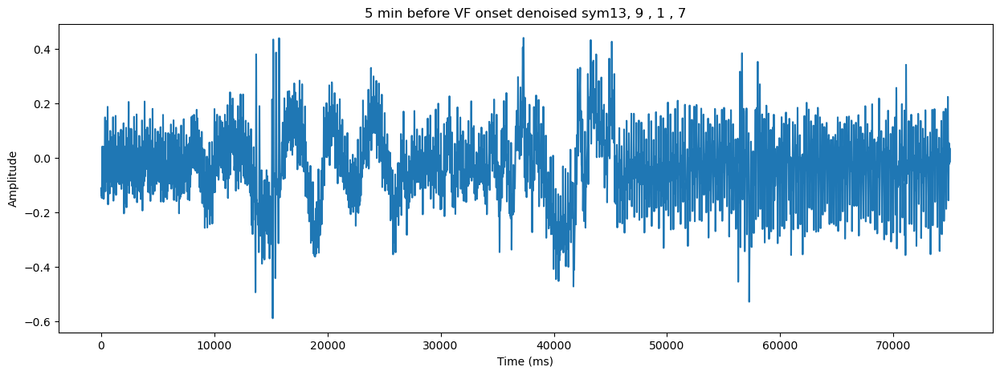

False


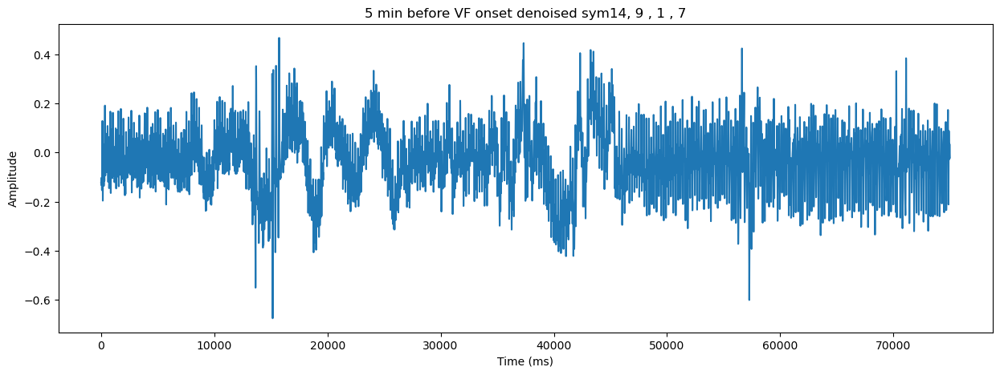

False


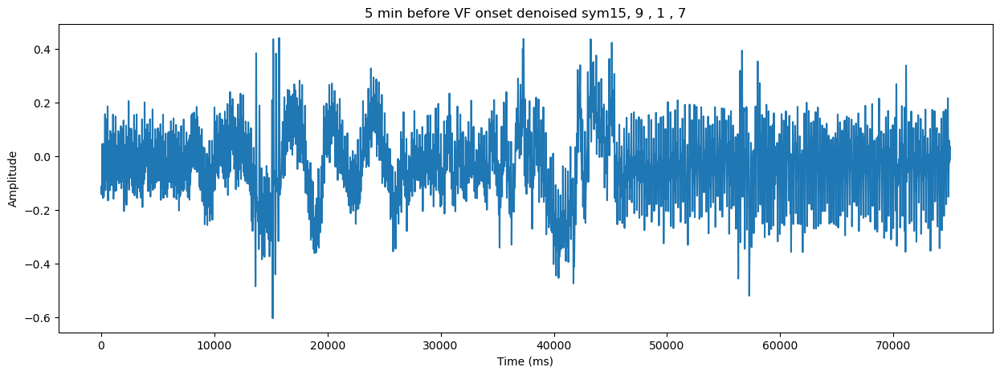

False


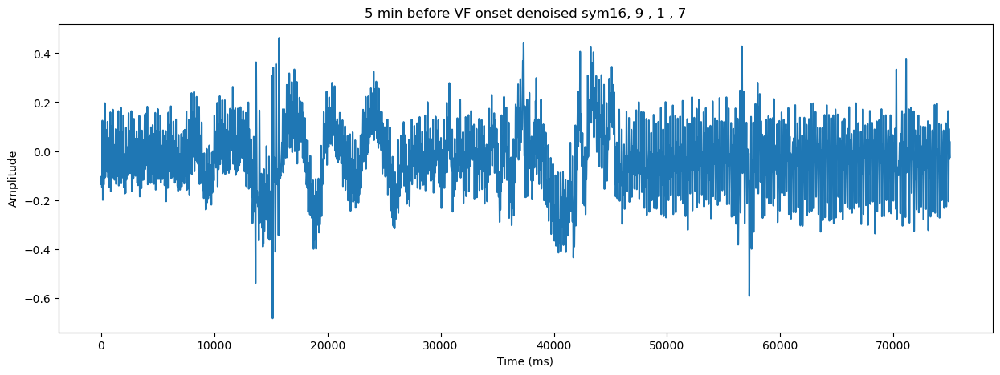

In [54]:
for i in range(len(biorfam)):
    scd_30_denoised_ex = denoise_signal(scd_30, symfam[i], 9, -5 , 5)
    print(np.any(np.isnan(scd_30_denoised_ex)))
    plt.figure(figsize=(15, 5))
    plt.subplot()
    plt.plot(scd_30_denoised_ex[-75000:])
    plt.title(f'5 min before VF onset denoised {symfam[i]}, 9 , 1 , 7')
    plt.xlabel('Time (ms)')
    plt.ylabel('Amplitude')
    
    plt.show()

# best result I hope

In [56]:
scd_30_denoised_sym5 = denoise_signal(scd_30, 'sym5', 9, -5 , 5)

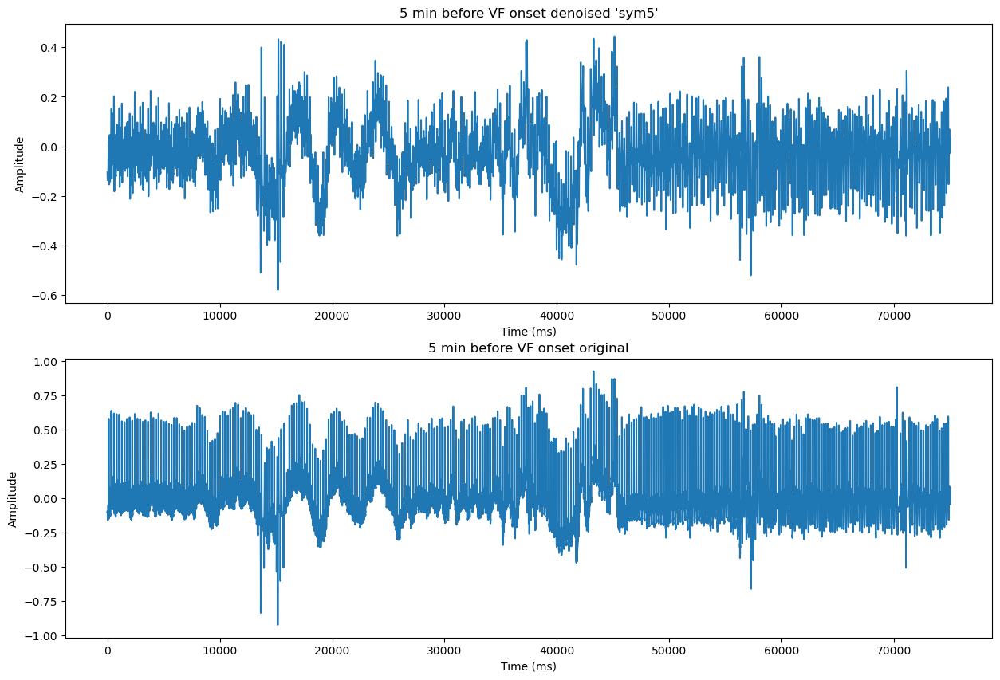

In [57]:
plt.figure(figsize=(15, 10))
plt.subplot(2, 1, 1)
plt.plot(scd_30_denoised_sym5[-75000:])
plt.title('5 min before VF onset denoised \'sym5\'')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.subplot(2, 1, 2)
plt.plot(scd_30[-75000:])
plt.title('5 min before VF onset original')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.show()

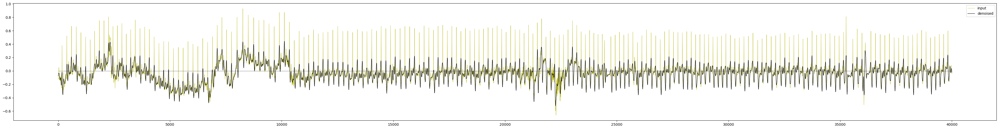

In [59]:
plt.figure(figsize=(50,6))

plt.plot(scd_30[-40000:], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(scd_30_denoised_sym5[-40000:], color='black', linewidth=0.9,label = 'denoised')
plt.hlines(0,0,40000,color='black', linewidth=0.4)
plt.legend()
plt.show()

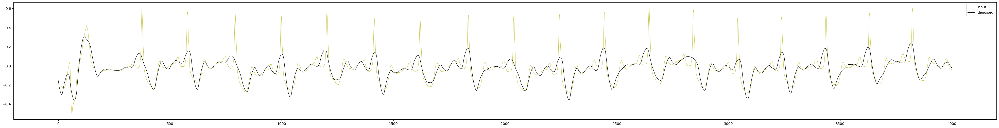

In [60]:
plt.figure(figsize=(50,6))

plt.plot(scd_30[-4000:], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(scd_30_denoised_sym5[-4000:], color='black', linewidth=0.9,label = 'denoised')
plt.hlines(0,0,4000,color='black', linewidth=0.4)
plt.legend()
plt.show()

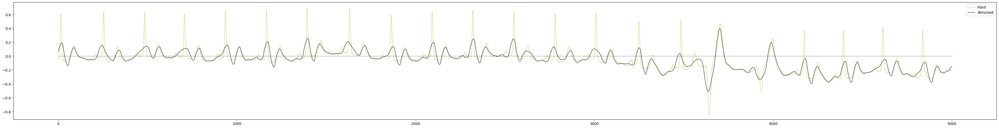

In [62]:
plt.figure(figsize=(50,6))

plt.plot(scd_30[-65000:-60000], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(scd_30_denoised_sym5[-65000:-60000], color='black', linewidth=0.9,label = 'denoised')
plt.hlines(0,0,5000,color='black', linewidth=0.4)
plt.legend()
plt.show()

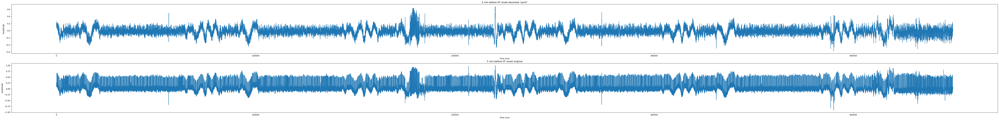

In [63]:
plt.figure(figsize=(90, 10))
plt.subplot(2, 1, 1)
plt.plot(scd_30_denoised_sym5)
plt.title('5 min before VF onset denoised \'sym5\'')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.subplot(2, 1, 2)
plt.plot(scd_30)
plt.title('5 min before VF onset original')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.show()

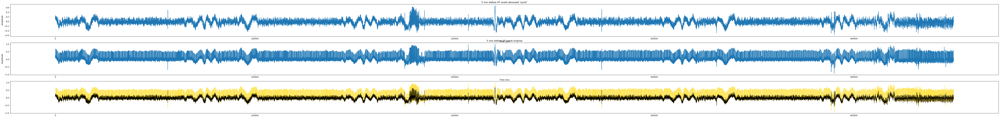

In [65]:
plt.figure(figsize=(90, 10))
plt.subplot(3, 1, 1)
plt.plot(scd_30_denoised_sym5)
plt.title('5 min before VF onset denoised \'sym5\'')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.subplot(3, 1, 2)
plt.plot(scd_30)
plt.title('5 min before VF onset original')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.subplot(3, 1, 3)
plt.plot(scd_30_denoised_sym5, color='black', linewidth=0.9,label = 'denoised')
plt.fill_between(np.arange(0,450000,1),scd_30,scd_30_denoised_sym5,color='gold',label = 'diff')
plt.hlines(0,0,450000,color='black', linewidth=0.4)

plt.show()

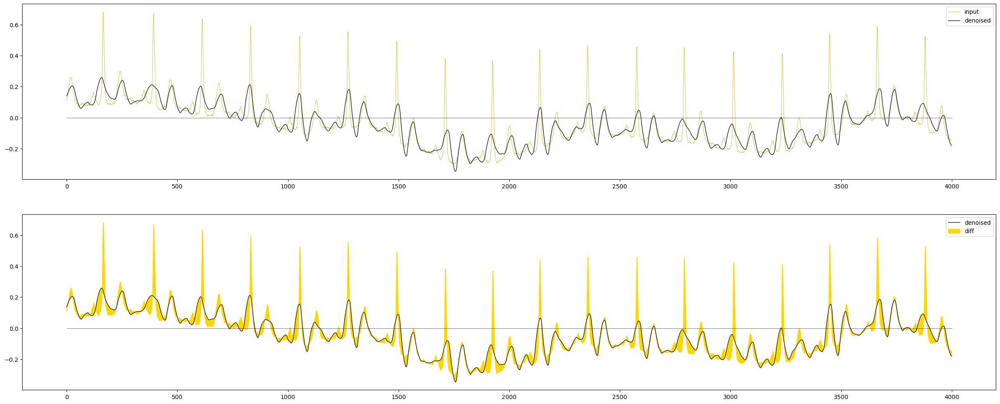

In [67]:
plt.figure(figsize=(30,12))
plt.subplot(2, 1, 1)
plt.plot(scd_30[0:4000], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(scd_30_denoised_sym5[0:4000], color='black', linewidth=0.9,label = 'denoised')
plt.hlines(0,0,4000,color='black', linewidth=0.4)
plt.legend()

plt.subplot(2, 1, 2)
plt.plot(scd_30_denoised_sym5[0:4000], color='black', linewidth=0.9,label = 'denoised')
plt.fill_between(np.arange(0,4000,1),scd_30[0:4000],scd_30_denoised_sym5[0:4000],color='gold',label = 'diff')
plt.hlines(0,0,4000,color='black', linewidth=0.4)
plt.legend()
plt.show()

# Baseline wandering

In [68]:
def get_median_filter_width(sampling_rate, duration):
    res = int( sampling_rate*duration )
    res += ((res%2) - 1) # needs to be an odd number
    return res

In [69]:
BASIC_SRATE = 250
ms_flt_array = [0.2,0.6]    #<-- length of baseline fitting filters (in seconds)
mfa = np.zeros(len(ms_flt_array), dtype='int')
for i in range(0, len(ms_flt_array)):
    mfa[i] = get_median_filter_width(BASIC_SRATE,ms_flt_array[i])

In [70]:
def filter_signal(X):
    global mfa
    X0 = X  #read orignal signal
    for mi in range(0,len(mfa)):
        X0 = medfilt(X0,mfa[mi]) # apply median filter one by one on top of each other
    X0 = np.subtract(X,X0)  # finally subtract from orignal signal
    return X0

In [71]:
scd_30_denoised_sym5_filtered = filter_signal(scd_30_denoised_sym5)
scd_30_denoised_sym5_filtered.shape

(450000,)

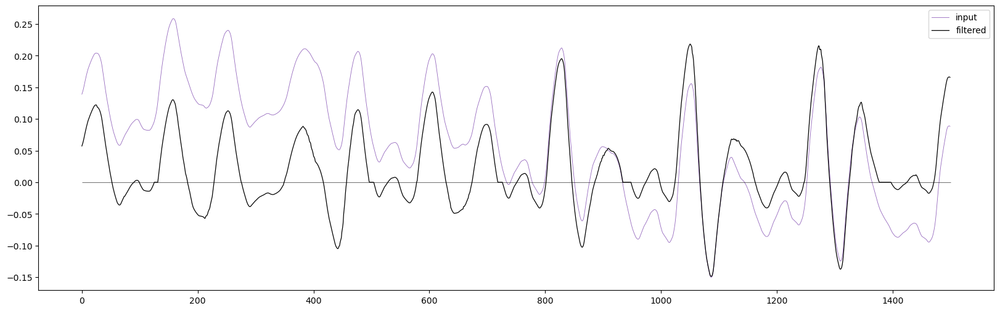

In [72]:
plt.figure(figsize=(20,6))

plt.plot(scd_30_denoised_sym5[:1500], color='tab:purple', linewidth=0.6,label = 'input')
plt.plot(scd_30_denoised_sym5_filtered[:1500], color='black', linewidth=0.9,label = 'filtered')
plt.hlines(0,0,1500,color='black', linewidth=0.4)
plt.legend()
plt.show()

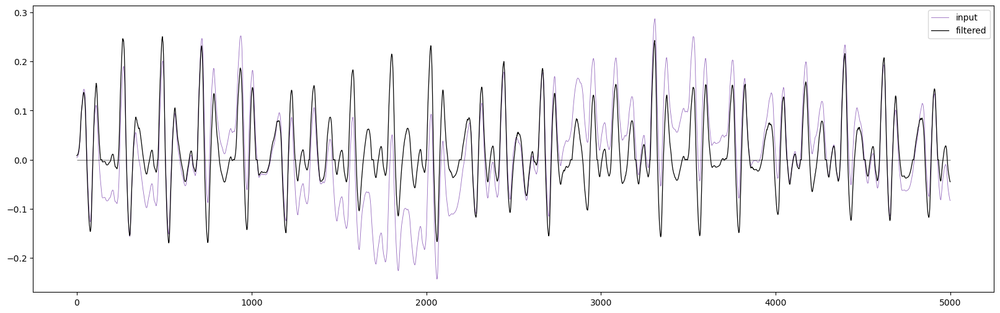

In [73]:
plt.figure(figsize=(20,6))

plt.plot(scd_30_denoised_sym5[10000:15000], color='tab:purple', linewidth=0.6,label = 'input')
plt.plot(scd_30_denoised_sym5_filtered[10000:15000], color='black', linewidth=0.9,label = 'filtered')
plt.hlines(0,0,5000,color='black', linewidth=0.4)
plt.legend()
plt.show()

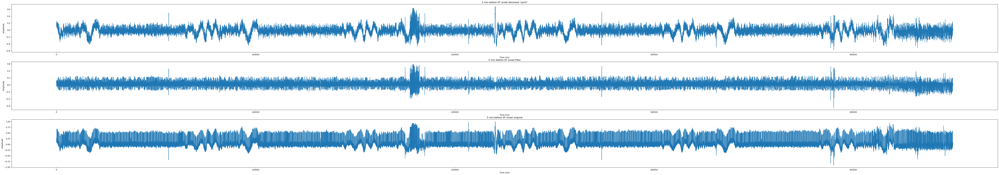

In [77]:
plt.figure(figsize=(90, 15))
plt.subplot(3, 1, 1)
plt.plot(scd_30_denoised_sym5)
plt.title('5 min before VF onset denoised \'sym5\'')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.subplot(3, 1, 2)
plt.plot(scd_30_denoised_sym5_filtered)
plt.title('5 min before VF onset filter')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.subplot(3, 1, 3)
plt.plot(scd_30)
plt.title('5 min before VF onset original')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.show()

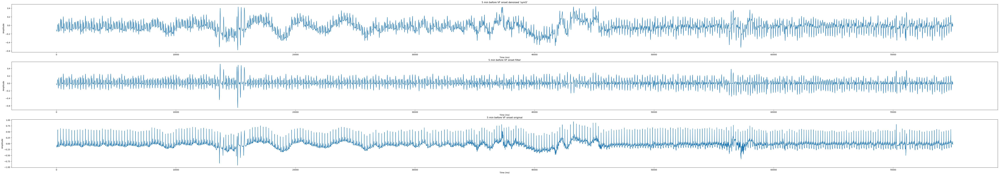

In [78]:
plt.figure(figsize=(90, 15))
plt.subplot(3, 1, 1)
plt.plot(scd_30_denoised_sym5[-75000:])
plt.title('5 min before VF onset denoised \'sym5\'')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.subplot(3, 1, 2)
plt.plot(scd_30_denoised_sym5_filtered[-75000:])
plt.title('5 min before VF onset filter')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.subplot(3, 1, 3)
plt.plot(scd_30[-75000:])
plt.title('5 min before VF onset original')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.show()

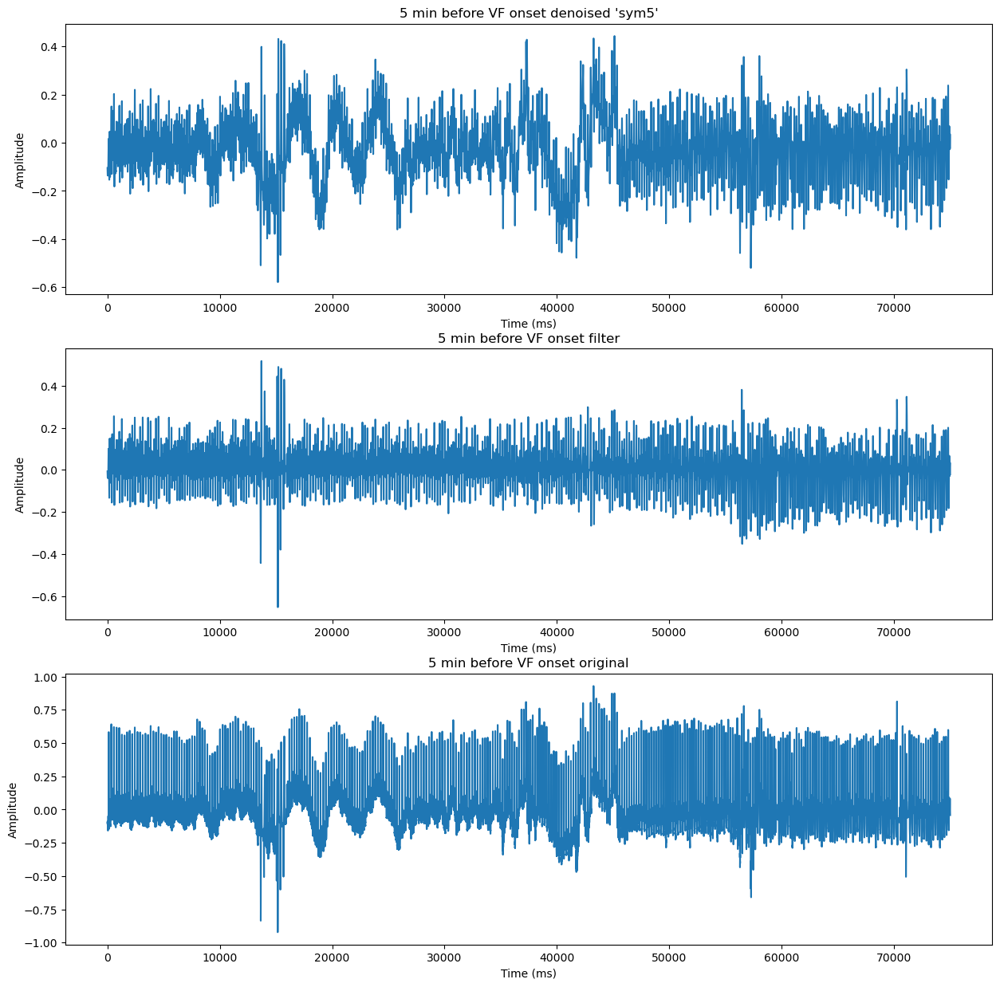

In [79]:
plt.figure(figsize=(15, 15))
plt.subplot(3, 1, 1)
plt.plot(scd_30_denoised_sym5[-75000:])
plt.title('5 min before VF onset denoised \'sym5\'')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.subplot(3, 1, 2)
plt.plot(scd_30_denoised_sym5_filtered[-75000:])
plt.title('5 min before VF onset filter')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.subplot(3, 1, 3)
plt.plot(scd_30[-75000:])
plt.title('5 min before VF onset original')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')

plt.show()

# R peak detect

In [80]:
from ecgdetectors import Detectors
BASIC_SRATE = 250

In [81]:
signal_pad_samples = 10
signal_pad = np.zeros(signal_pad_samples) # pad one sec to detect initial peaks properly
scd_30_denoised_sym5_filtered_r_peak = scd_30_denoised_sym5_filtered
detectors = Detectors(BASIC_SRATE)

In [83]:
detectors = {
            'pan_tompkins_detector':[detectors.pan_tompkins_detector, []],
            'hamilton_detector':[detectors.hamilton_detector, []],
            'christov_detector':[detectors.christov_detector, []],
            'engzee_detector':[detectors.engzee_detector, []],
            'swt_detector':[detectors.swt_detector, []],
            'two_average_detector':[detectors.two_average_detector, []],
            }

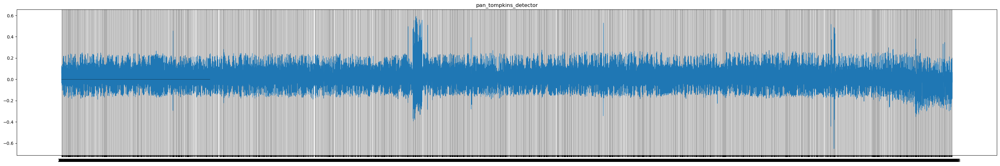

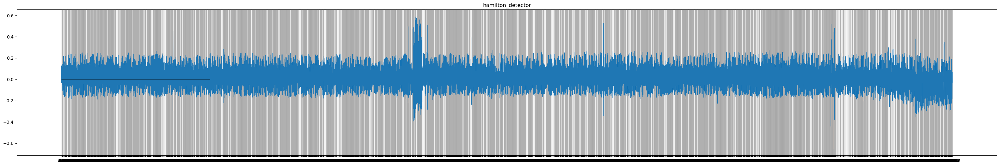

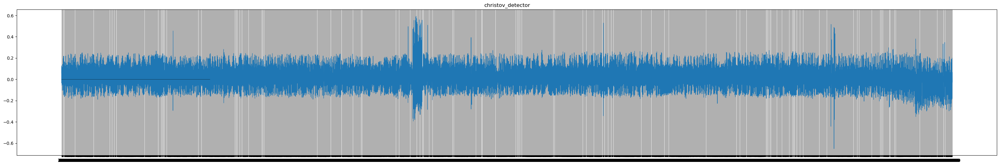

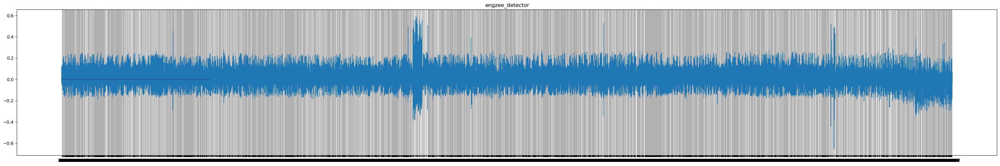

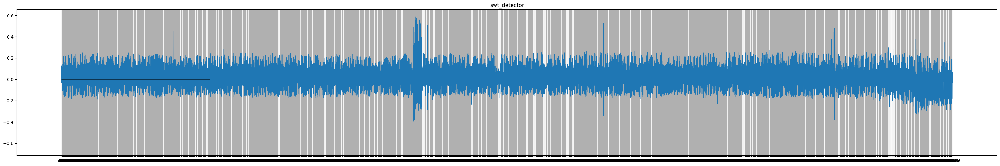

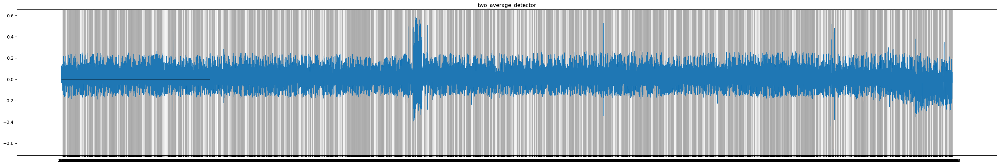

In [84]:
for kd in detectors.keys():
    vd = detectors[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,scd_30_denoised_sym5_filtered)))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(40,6))
    plt.title(kd)
    plt.plot(scd_30_denoised_sym5_filtered_r_peak,color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,75000,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

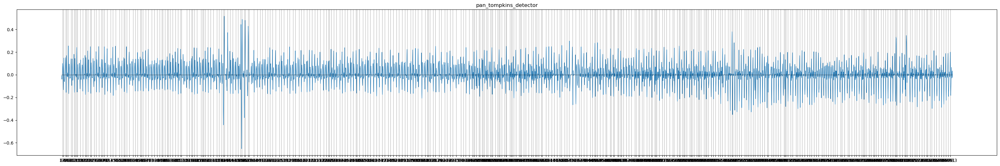

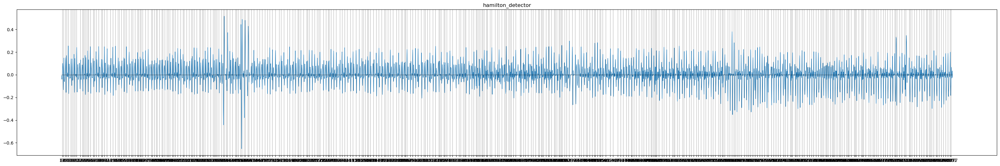

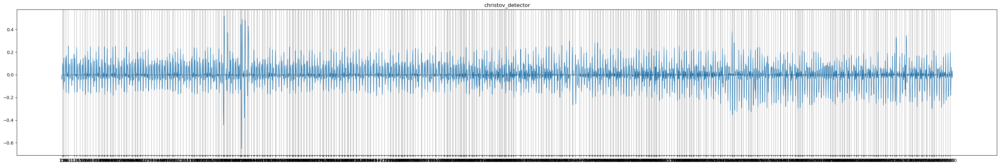

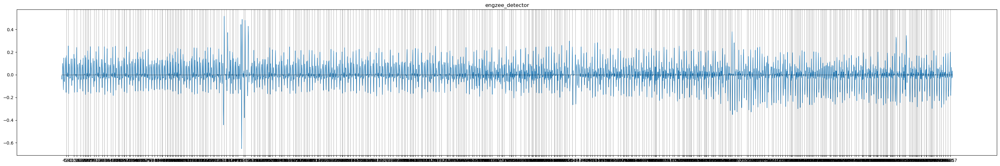

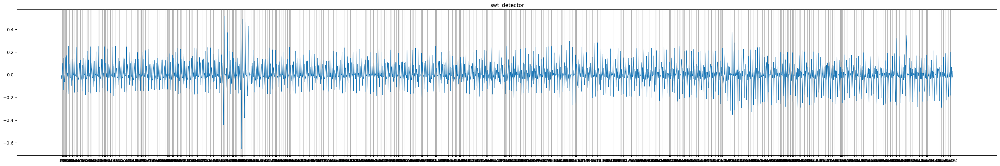

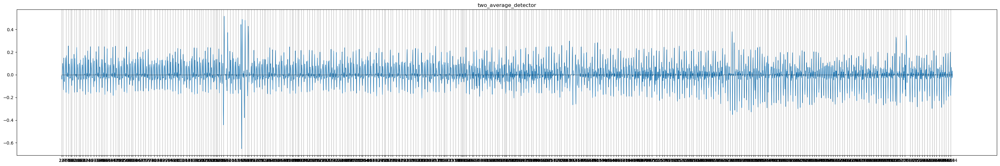

In [85]:
xx = scd_30_denoised_sym5_filtered[-75000:]
scd_30_denoised_sym5_filtered_r_peak_2 = scd_30_denoised_sym5_filtered[-75000:]

for kd in detectors.keys():
    vd = detectors[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,xx)))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(40,6))
    plt.title(kd)
    plt.plot(scd_30_denoised_sym5_filtered_r_peak_2,color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,75000,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

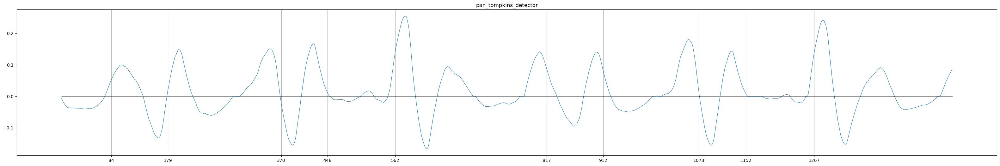

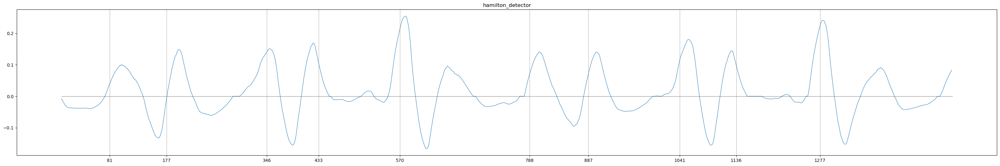

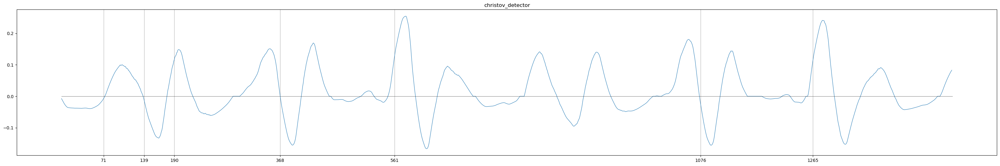

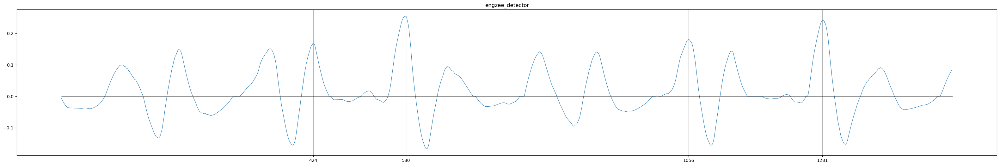

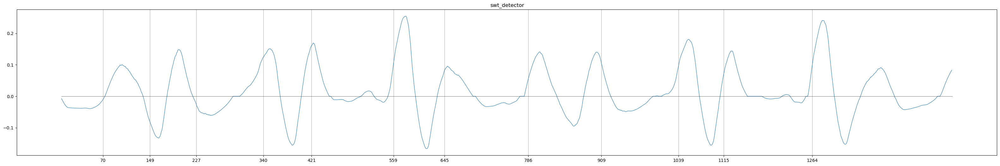

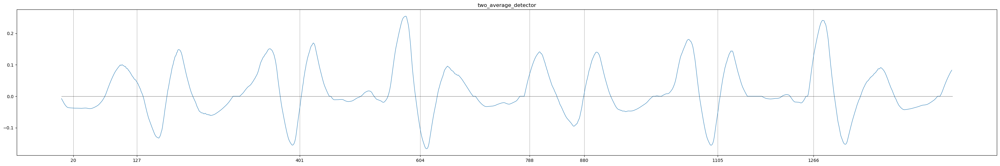

In [89]:
xx = scd_30_denoised_sym5_filtered[-75000:]
xxx = xx[:1500]
scd_30_denoised_sym5_filtered_r_peak_2 = xx[:1500]

for kd in detectors.keys():
    vd = detectors[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,xxx)))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(40,6))
    plt.title(kd)
    plt.plot(scd_30_denoised_sym5_filtered_r_peak_2,color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,1500,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

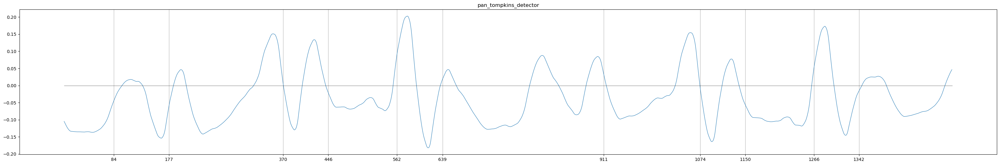

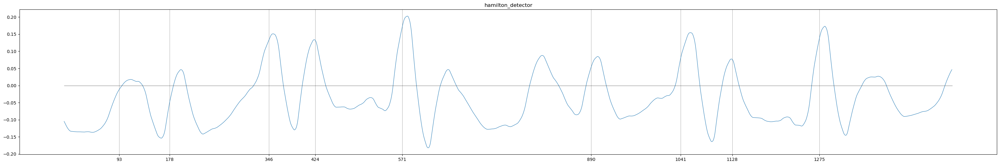

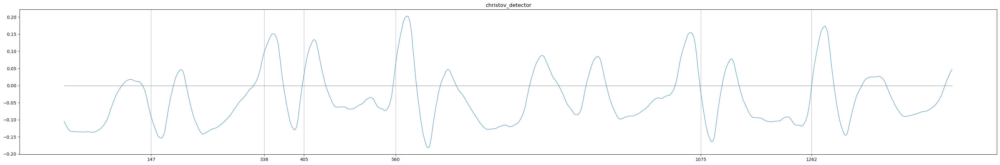

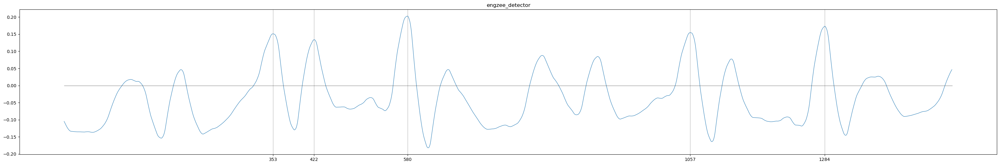

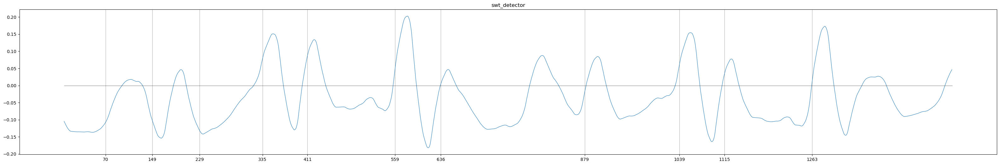

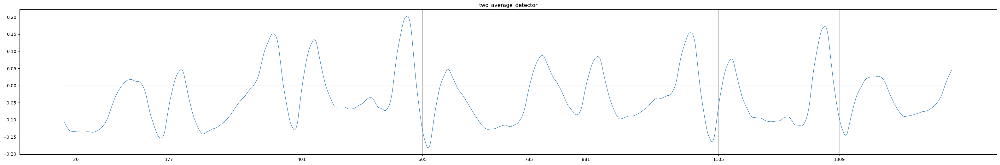

In [90]:
xx = scd_30_denoised_sym5[-75000:]
xxx = xx[:1500]
scd_30_denoised_sym5_filtered_r_peak_2 = xx[:1500]

for kd in detectors.keys():
    vd = detectors[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,xxx)))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(40,6))
    plt.title(kd)
    plt.plot(scd_30_denoised_sym5_filtered_r_peak_2,color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,1500,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

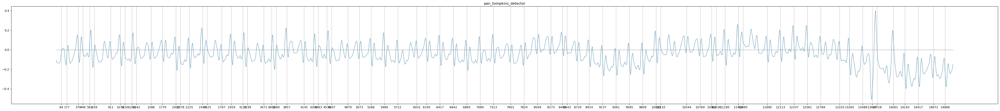

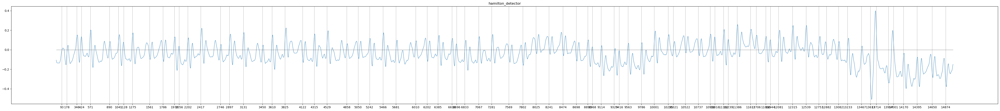

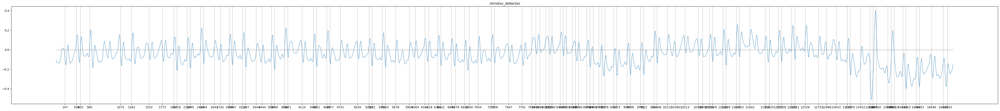

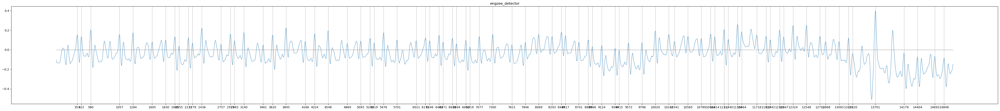

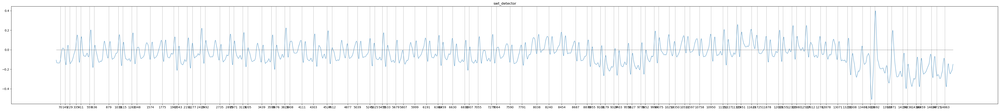

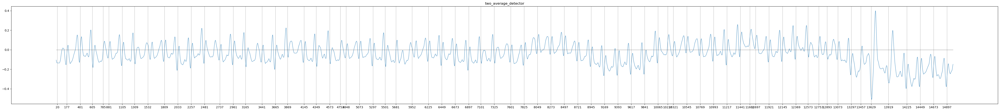

In [91]:
xx = scd_30_denoised_sym5[-75000:]
xxx = xx[:15000]
scd_30_denoised_sym5_filtered_r_peak_2 = xx[:15000]

for kd in detectors.keys():
    vd = detectors[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,xxx)))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(60,6))
    plt.title(kd)
    plt.plot(scd_30_denoised_sym5_filtered_r_peak_2,color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,15000,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

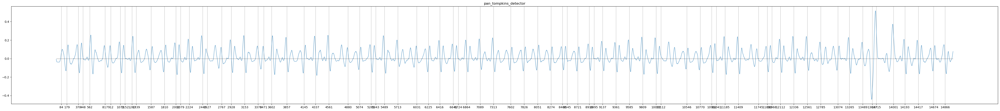

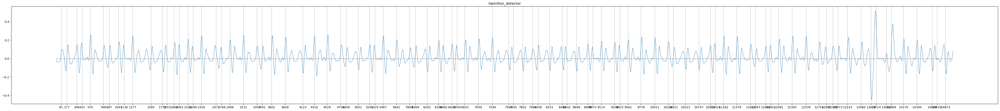

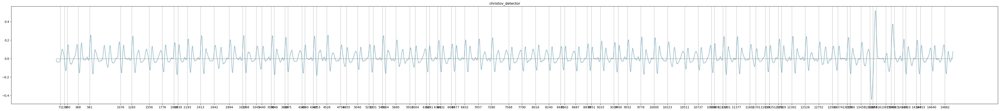

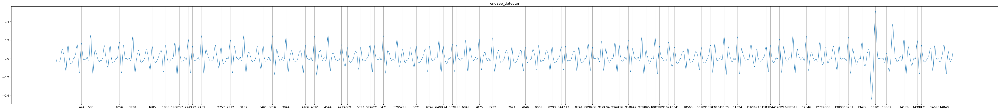

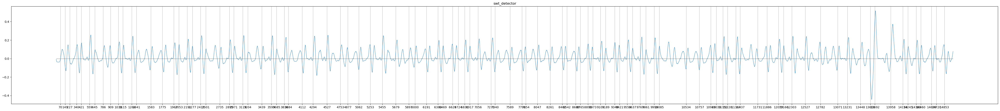

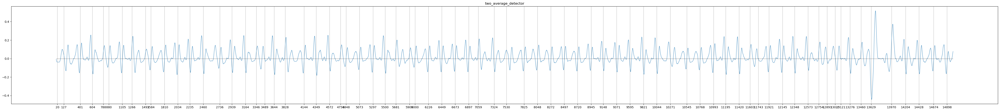

In [92]:
xx = scd_30_denoised_sym5_filtered[-75000:]
xxx = xx[:15000]
scd_30_denoised_sym5_filtered_r_peak_2 = xx[:15000]

for kd in detectors.keys():
    vd = detectors[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,xxx)))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(60,6))
    plt.title(kd)
    plt.plot(scd_30_denoised_sym5_filtered_r_peak_2,color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,15000,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

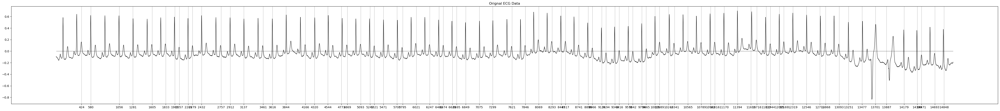

In [93]:
data_signal_4 = scd_30_denoised_sym5_filtered_r_peak_2
data_peaks_4 = detectors['engzee_detector'][1]
segments = scd_30[-75000:]

plt.figure(figsize=(60,6))
plt.title('Orignal ECG Data')
plt.plot(segments[:15000],color='black',linewidth=0.9)
plt.hlines(0,0,15000,color='black', linewidth=0.5)
plt.xticks(data_peaks_4)
plt.grid(axis='x')
plt.show()

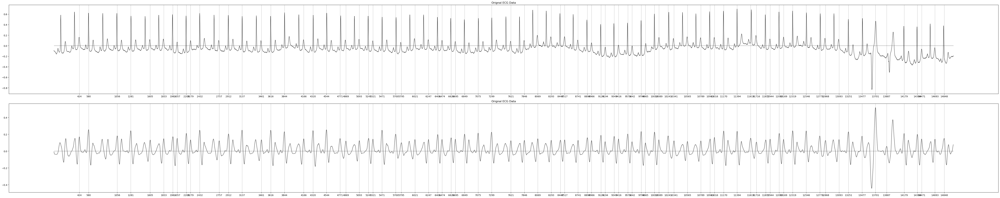

In [94]:
plt.figure(figsize=(60,12))

plt.subplot(2, 1, 1)

plt.title('Orignal ECG Data')
plt.plot(segments[:15000],color='black',linewidth=0.9)
plt.hlines(0,0,15000,color='black', linewidth=0.5)
plt.xticks(data_peaks_4)
plt.grid(axis='x')

plt.subplot(2, 1, 2)
plt.title('Orignal ECG Data')
plt.plot(scd_30_denoised_sym5_filtered_r_peak_2[:15000],color='black',linewidth=0.9)
plt.hlines(0,0,15000,color='black', linewidth=0.5)
plt.xticks(data_peaks_4)
plt.grid(axis='x')
plt.tight_layout()
plt.show()

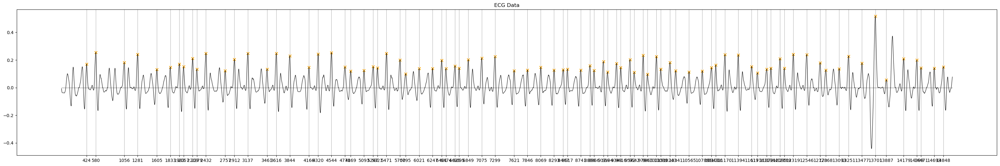

In [95]:
plt.figure(figsize=(40,6))
plt.title('ECG Data')
plt.plot(scd_30_denoised_sym5_filtered_r_peak_2[:15000],color='black',linewidth=0.8)
plt.scatter(data_peaks_4, data_signal_4[:15000][data_peaks_4], color='orange', marker='x', label='R-peaks')
plt.hlines(0,0,15000,color='black', linewidth=0.4)
plt.xticks(data_peaks_4)
plt.grid(axis='x')
plt.show()


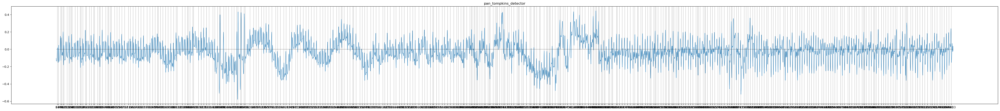

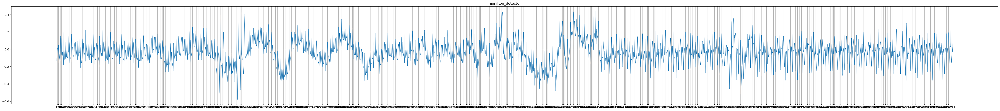

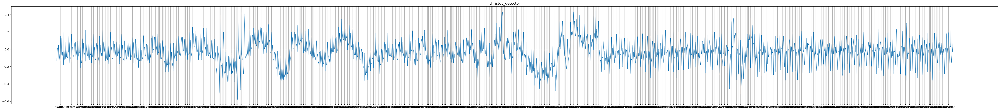

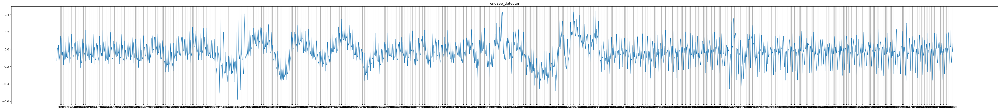

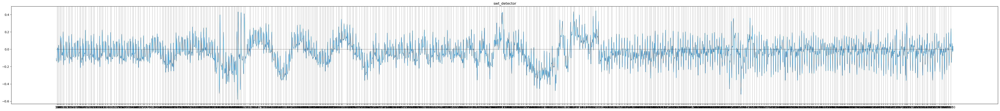

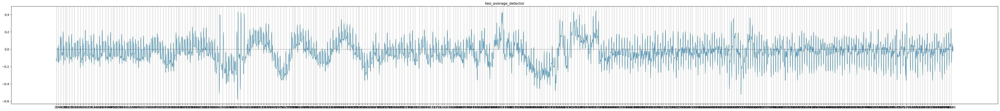

In [96]:
xx = scd_30_denoised_sym5[-75000:]
scd_30_denoised_sym5_r_peak_ = xx

for kd in detectors.keys():
    vd = detectors[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,scd_30_denoised_sym5_r_peak_)))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(60,6))
    plt.title(kd)
    plt.plot(scd_30_denoised_sym5_r_peak_,color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,75000,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

In [97]:
data_signal_5 = scd_30_denoised_sym5_r_peak_
data_peaks_5 = detectors['engzee_detector'][1]
segments = scd_30_denoised_sym5[-75000:]

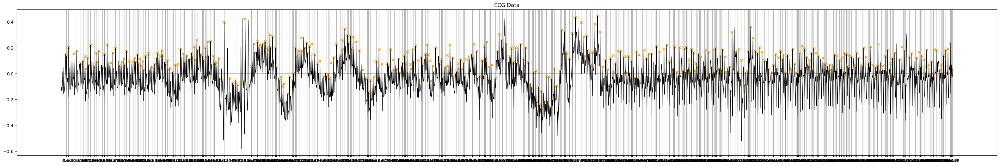

In [98]:
plt.figure(figsize=(40,6))
plt.title('ECG Data')
plt.plot(segments,color='black',linewidth=0.8)
plt.scatter(data_peaks_5, data_signal_5[data_peaks_5], color='orange', marker='x', label='R-peaks')
plt.hlines(0,0,75000,color='black', linewidth=0.4)
plt.xticks(data_peaks_5)
plt.grid(axis='x')
plt.show()


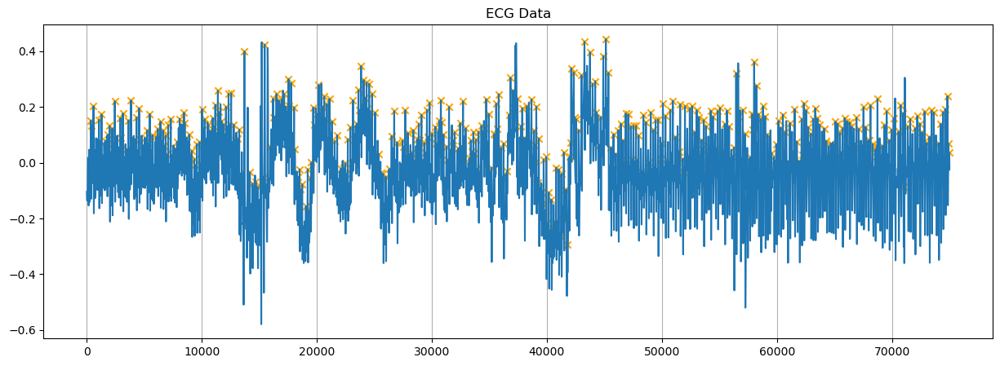

In [104]:
plt.figure(figsize=(15,5))
plt.title('ECG Data')
plt.plot(segments)
plt.scatter(data_peaks_5, data_signal_5[data_peaks_5], color='orange', marker='x', label='R-peaks')
#plt.hlines(0,0,75000,color='black', linewidth=0.4)
#plt.xticks(data_peaks_5)
plt.grid(axis='x')
plt.show()


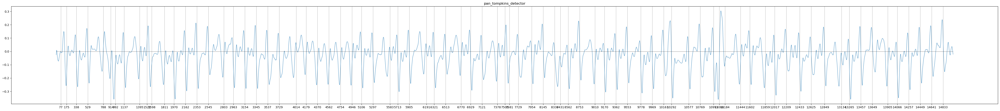

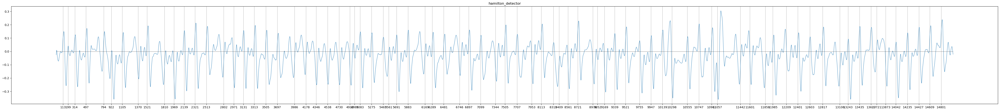

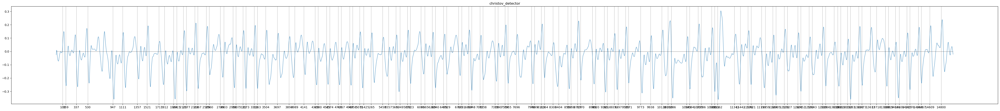

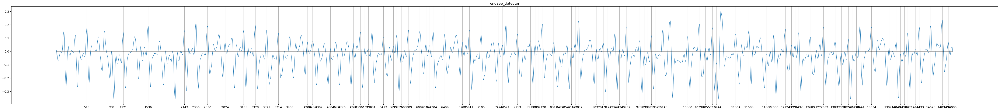

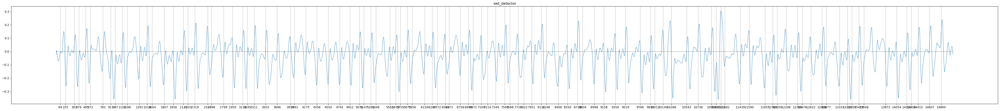

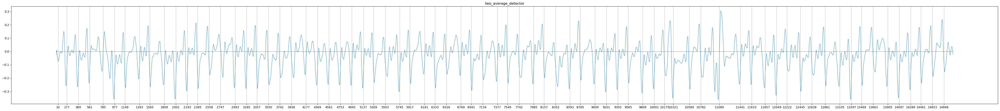

In [106]:
xx = scd_30_denoised_sym5[-75000:]
scd_30_denoised_sym5_r_peak_ = xx[-15000:]

for kd in detectors.keys():
    vd = detectors[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,scd_30_denoised_sym5_r_peak_)))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(60,6))
    plt.title(kd)
    plt.plot(scd_30_denoised_sym5_r_peak_,color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,15000,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

In [107]:
data_signal_5 = scd_30_denoised_sym5_r_peak_
data_peaks_5 = detectors['engzee_detector'][1]
segments = scd_30_denoised_sym5[-15000:]

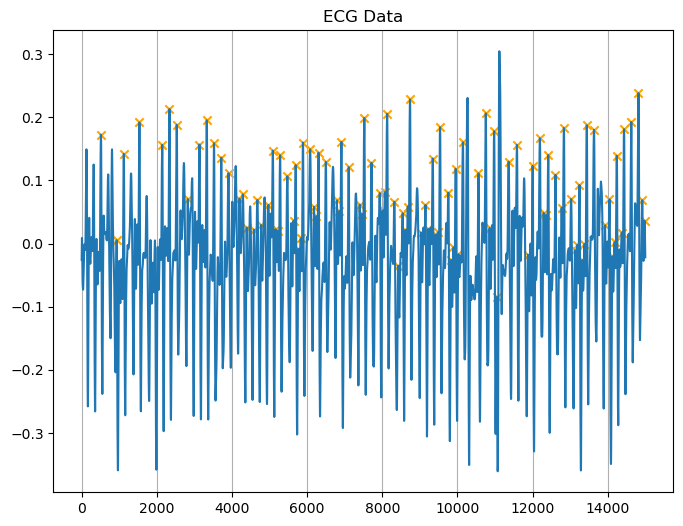

In [111]:
plt.figure(figsize=(8,6))
plt.title('ECG Data')
plt.plot(segments[-15000:])
plt.scatter(data_peaks_5, data_signal_5[-15000:][data_peaks_5], color='orange', marker='x', label='R-peaks')
#plt.hlines(0,0,75000,color='black', linewidth=0.4)
#plt.xticks(data_peaks_5)
plt.grid(axis='x')
plt.show()

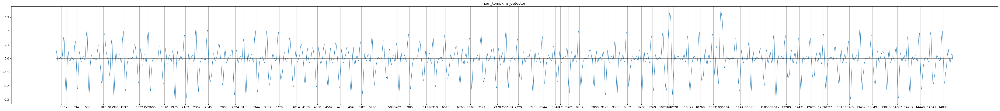

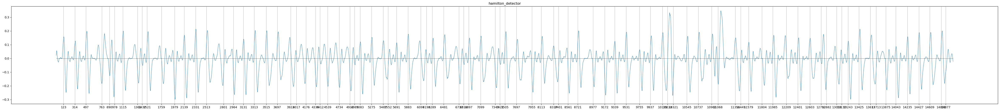

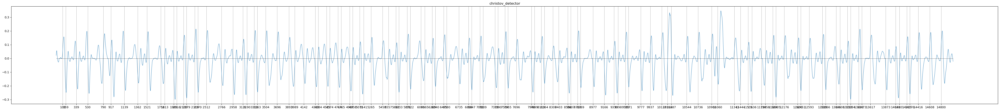

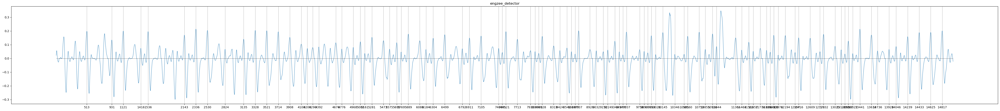

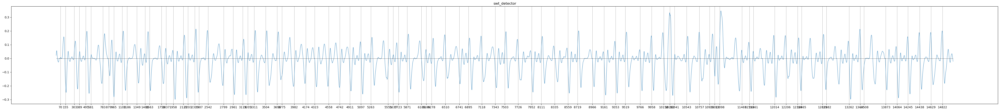

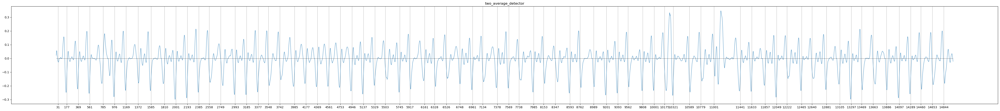

In [112]:
xx = scd_30_denoised_sym5_filtered[-75000:]
scd_30_denoised_sym5_r_peak_ = xx[-15000:]

for kd in detectors.keys():
    vd = detectors[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,scd_30_denoised_sym5_r_peak_)))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(60,6))
    plt.title(kd)
    plt.plot(scd_30_denoised_sym5_r_peak_,color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,15000,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

In [113]:
data_signal_5 = scd_30_denoised_sym5_r_peak_
data_peaks_5 = detectors['engzee_detector'][1]
segments = scd_30_denoised_sym5_filtered[-15000:]

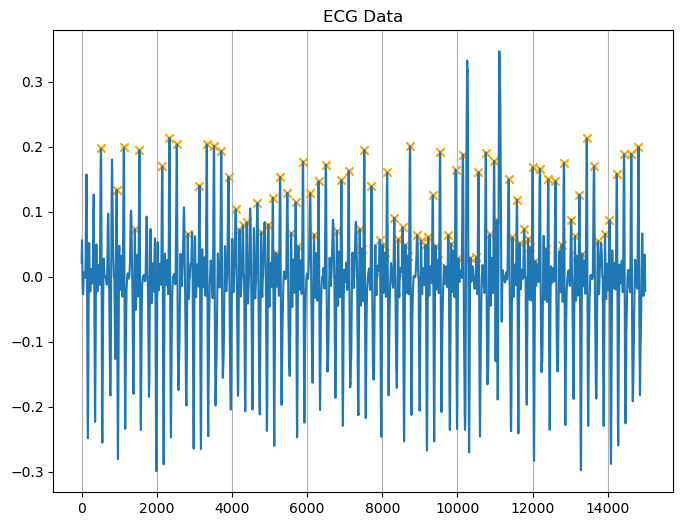

In [114]:
plt.figure(figsize=(8,6))
plt.title('ECG Data')
plt.plot(segments[-15000:])
plt.scatter(data_peaks_5, data_signal_5[-15000:][data_peaks_5], color='orange', marker='x', label='R-peaks')
#plt.hlines(0,0,75000,color='black', linewidth=0.4)
#plt.xticks(data_peaks_5)
plt.grid(axis='x')
plt.show()